# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

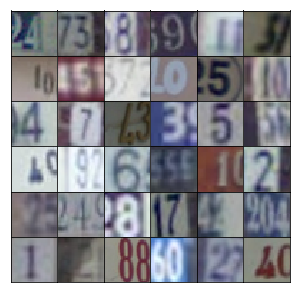

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min_, max_ = feature_range
    x = x * (max_ - min_) + min_
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def leaky_relu(x, alpha=1e-1):
    return tf.maximum(alpha*x, x)

def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        channels = 256
        # First fully connected layer
        x = tf.layers.dense(z, 4 * 4 * channels)
        x = tf.reshape(x, (-1, 4, 4, channels))
        x = tf.layers.batch_normalization(x, training=training)
        x = leaky_relu(x, alpha=alpha)
        # 4x4x1024
        
        channels //= 2
        c0 = tf.layers.conv2d_transpose(x, channels, 5, strides=(2, 2), padding='same')
        c0 = tf.layers.batch_normalization(c0, training=training)
        c0 = leaky_relu(c0, alpha=alpha)
        # 8x8x512
        
        channels //= 2
        c1 = tf.layers.conv2d_transpose(c0, channels, 5, strides=(2,2), padding='same')
        c1 = tf.layers.batch_normalization(c1, training=training)
        c1 = leaky_relu(c1, alpha=alpha)
        # 16x16x256
        
        c2 = tf.layers.conv2d_transpose(c1, output_dim, 5, strides=(2,2), padding='same')
        # 32x32x3                

        logits = c2
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('discriminator', reuse=reuse):
        n_filters = 16
        # Input layer is 32x32x3
        c0 = tf.layers.conv2d(x, n_filters, 5, strides=(2,2), padding='same')
        # c0 = tf.layers.batch_normalization(c0, training=training)
        c0 = leaky_relu(c0, alpha=alpha)
        # 16x16x64
        
        n_filters *= 2
        c1 = tf.layers.conv2d(c0, n_filters, 5, strides=(2,2), padding='same')
        c1 = tf.layers.batch_normalization(c1, training=training)
        c1 = leaky_relu(c1, alpha=alpha)
        # 8x8x128
        
        n_filters *= 2
        c2 = tf.layers.conv2d(c1, n_filters, 5, strides=(2,2), padding='same')
        c2 = tf.layers.batch_normalization(c2, training=training)
        c2 = leaky_relu(c2, alpha=alpha)
        # 4x4x256
        sz = c2.get_shape().as_list()
        size = sz[1] * sz[2] * sz[3]
        
        logits = tf.layers.dense(tf.reshape(c2, (-1, size)), 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [20]:
real_size = (32,32,3)
z_size = 100
learning_rate = 2e-4
batch_size = 64
epochs = 100
alpha = 1e-1
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/100... Discriminator Loss: 0.9311... Generator Loss: 0.9871
Epoch 1/100... Discriminator Loss: 0.6055... Generator Loss: 1.6289
Epoch 1/100... Discriminator Loss: 1.1133... Generator Loss: 0.8688


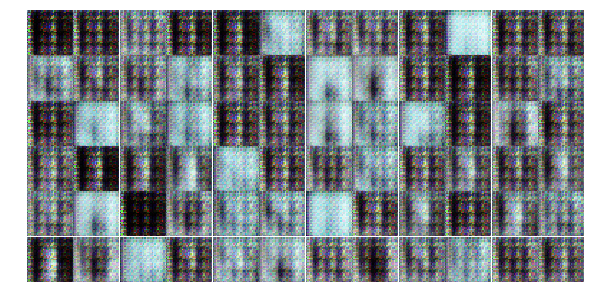

Epoch 1/100... Discriminator Loss: 1.0663... Generator Loss: 1.0262
Epoch 1/100... Discriminator Loss: 0.8561... Generator Loss: 0.8328
Epoch 2/100... Discriminator Loss: 1.0784... Generator Loss: 0.8037


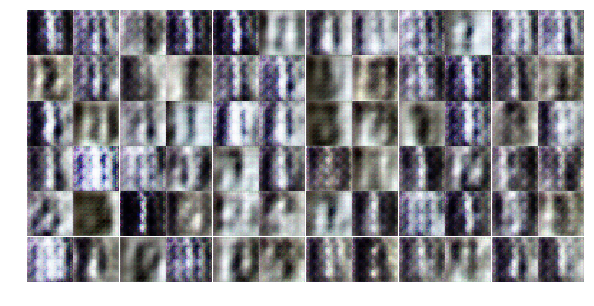

Epoch 2/100... Discriminator Loss: 1.1356... Generator Loss: 0.9021
Epoch 2/100... Discriminator Loss: 1.3037... Generator Loss: 0.7807
Epoch 2/100... Discriminator Loss: 1.3091... Generator Loss: 0.6896
Epoch 2/100... Discriminator Loss: 1.4880... Generator Loss: 0.8353


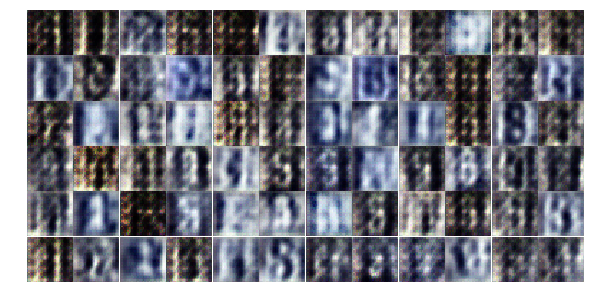

Epoch 2/100... Discriminator Loss: 1.2610... Generator Loss: 0.8553
Epoch 3/100... Discriminator Loss: 1.4419... Generator Loss: 0.6781
Epoch 3/100... Discriminator Loss: 1.3614... Generator Loss: 0.7050


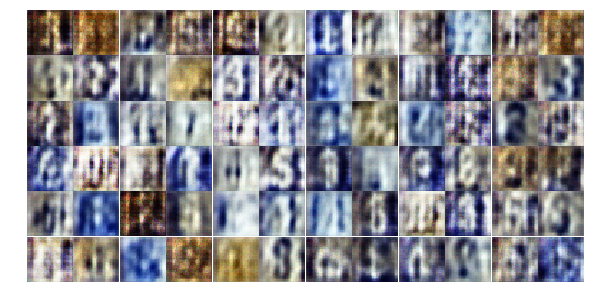

Epoch 3/100... Discriminator Loss: 1.4116... Generator Loss: 0.7626
Epoch 3/100... Discriminator Loss: 1.3662... Generator Loss: 0.6899
Epoch 3/100... Discriminator Loss: 1.5655... Generator Loss: 0.6677


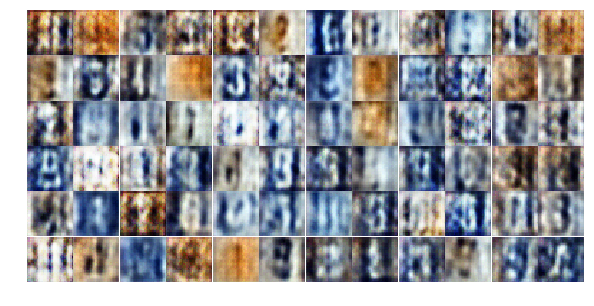

Epoch 3/100... Discriminator Loss: 1.2326... Generator Loss: 0.7759
Epoch 4/100... Discriminator Loss: 1.1569... Generator Loss: 0.7912
Epoch 4/100... Discriminator Loss: 1.2892... Generator Loss: 0.7722
Epoch 4/100... Discriminator Loss: 1.2492... Generator Loss: 0.7524


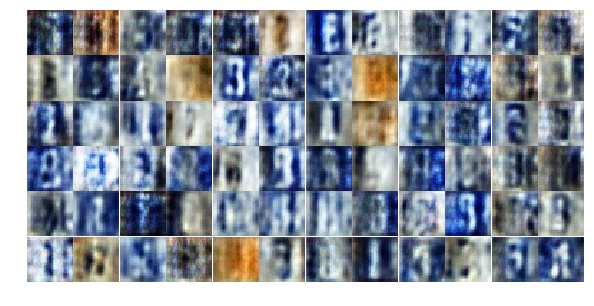

Epoch 4/100... Discriminator Loss: 1.3315... Generator Loss: 0.7182
Epoch 4/100... Discriminator Loss: 1.1532... Generator Loss: 0.8604
Epoch 4/100... Discriminator Loss: 1.2909... Generator Loss: 0.6848


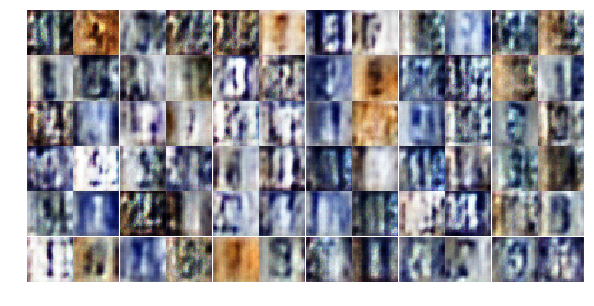

Epoch 5/100... Discriminator Loss: 1.2718... Generator Loss: 0.8613
Epoch 5/100... Discriminator Loss: 1.3757... Generator Loss: 0.6871
Epoch 5/100... Discriminator Loss: 1.3339... Generator Loss: 0.6893


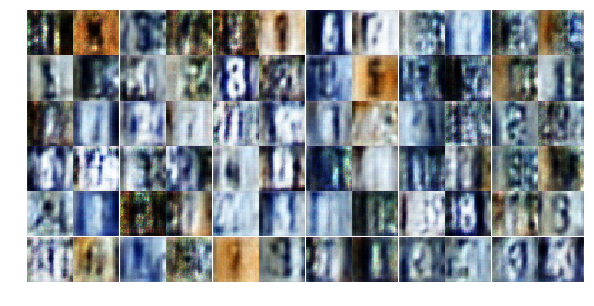

Epoch 5/100... Discriminator Loss: 1.0225... Generator Loss: 0.8695
Epoch 5/100... Discriminator Loss: 1.1800... Generator Loss: 0.6996
Epoch 5/100... Discriminator Loss: 0.8665... Generator Loss: 1.2239
Epoch 6/100... Discriminator Loss: 1.0949... Generator Loss: 0.9291


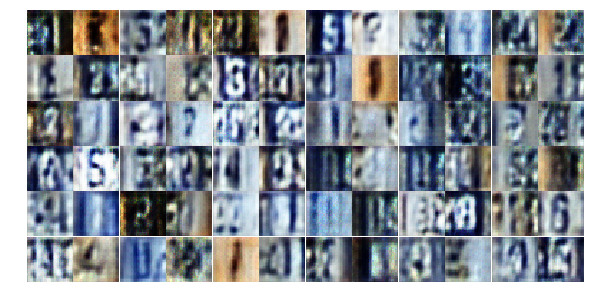

Epoch 6/100... Discriminator Loss: 1.0781... Generator Loss: 0.8393
Epoch 6/100... Discriminator Loss: 1.3160... Generator Loss: 0.7457
Epoch 6/100... Discriminator Loss: 1.0805... Generator Loss: 0.7359


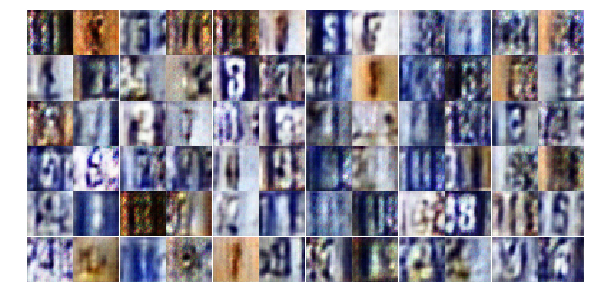

Epoch 6/100... Discriminator Loss: 1.0319... Generator Loss: 0.9986
Epoch 6/100... Discriminator Loss: 0.8245... Generator Loss: 1.0894
Epoch 7/100... Discriminator Loss: 1.1949... Generator Loss: 0.7726


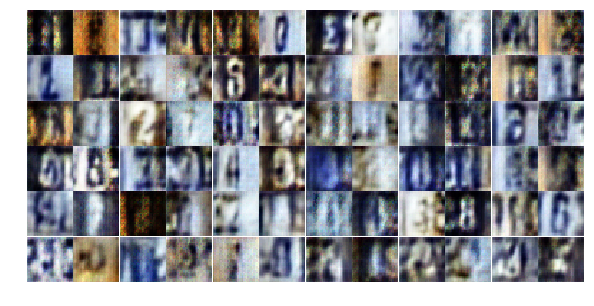

Epoch 7/100... Discriminator Loss: 1.2837... Generator Loss: 0.5945
Epoch 7/100... Discriminator Loss: 0.9439... Generator Loss: 0.8496
Epoch 7/100... Discriminator Loss: 1.0295... Generator Loss: 0.7643
Epoch 7/100... Discriminator Loss: 1.0992... Generator Loss: 0.8111


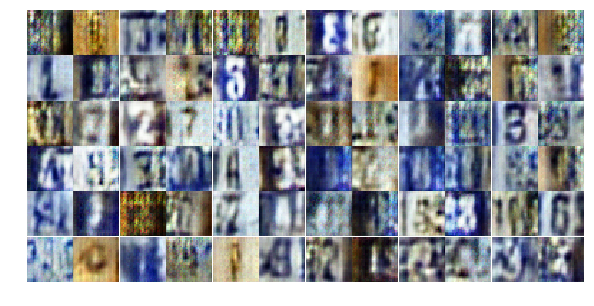

Epoch 7/100... Discriminator Loss: 1.3045... Generator Loss: 0.6759
Epoch 8/100... Discriminator Loss: 1.3678... Generator Loss: 0.6001
Epoch 8/100... Discriminator Loss: 1.1934... Generator Loss: 0.8541


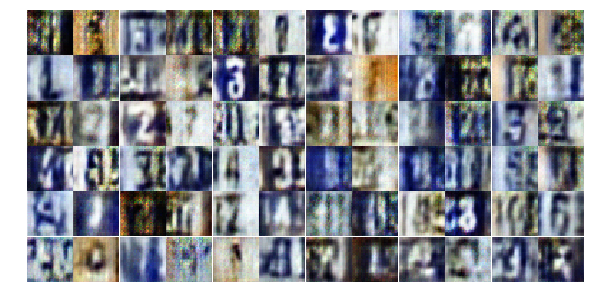

Epoch 8/100... Discriminator Loss: 1.2983... Generator Loss: 0.6487
Epoch 8/100... Discriminator Loss: 1.2104... Generator Loss: 0.7196
Epoch 8/100... Discriminator Loss: 1.3211... Generator Loss: 0.7162


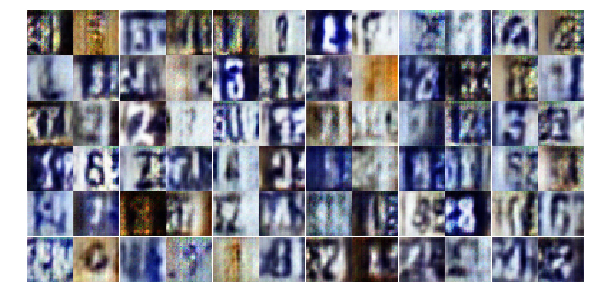

Epoch 8/100... Discriminator Loss: 1.2128... Generator Loss: 0.7019
Epoch 9/100... Discriminator Loss: 1.2443... Generator Loss: 0.7902
Epoch 9/100... Discriminator Loss: 1.1748... Generator Loss: 0.7322
Epoch 9/100... Discriminator Loss: 0.9596... Generator Loss: 0.8999


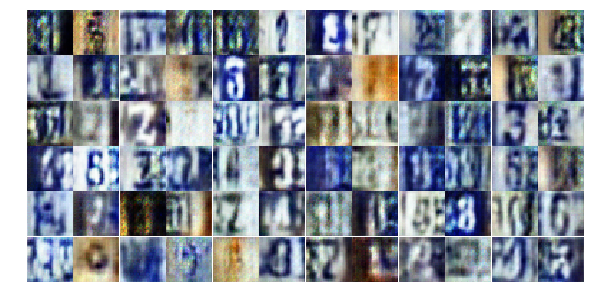

Epoch 9/100... Discriminator Loss: 1.6250... Generator Loss: 0.5494
Epoch 9/100... Discriminator Loss: 1.0188... Generator Loss: 0.8630
Epoch 9/100... Discriminator Loss: 1.0141... Generator Loss: 0.8746


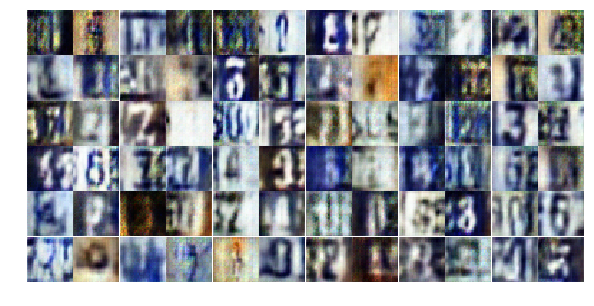

Epoch 10/100... Discriminator Loss: 1.2005... Generator Loss: 0.6421
Epoch 10/100... Discriminator Loss: 1.3440... Generator Loss: 0.5538
Epoch 10/100... Discriminator Loss: 1.0696... Generator Loss: 0.7176


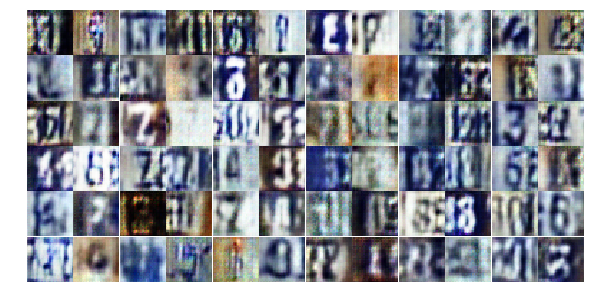

Epoch 10/100... Discriminator Loss: 1.3433... Generator Loss: 0.5959
Epoch 10/100... Discriminator Loss: 1.4577... Generator Loss: 0.5259
Epoch 10/100... Discriminator Loss: 0.9203... Generator Loss: 0.9086
Epoch 11/100... Discriminator Loss: 1.1293... Generator Loss: 0.7377


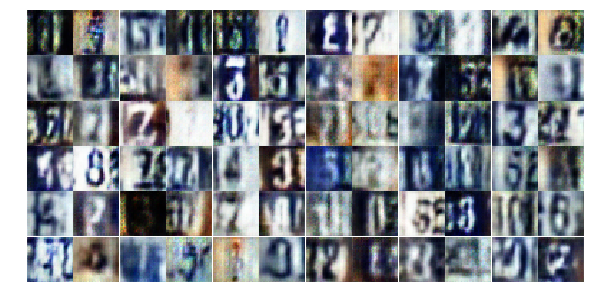

Epoch 11/100... Discriminator Loss: 1.0849... Generator Loss: 0.7417
Epoch 11/100... Discriminator Loss: 1.2195... Generator Loss: 0.8446
Epoch 11/100... Discriminator Loss: 1.2557... Generator Loss: 0.7987


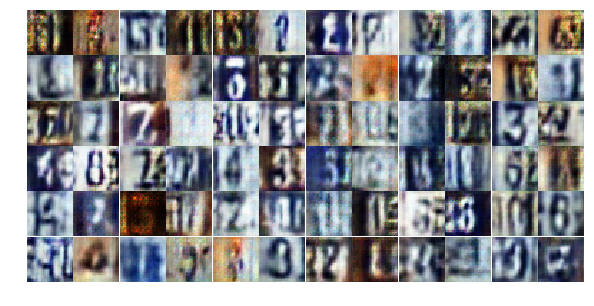

Epoch 11/100... Discriminator Loss: 1.4339... Generator Loss: 0.5435
Epoch 11/100... Discriminator Loss: 1.3109... Generator Loss: 0.6020
Epoch 12/100... Discriminator Loss: 1.1744... Generator Loss: 0.6623


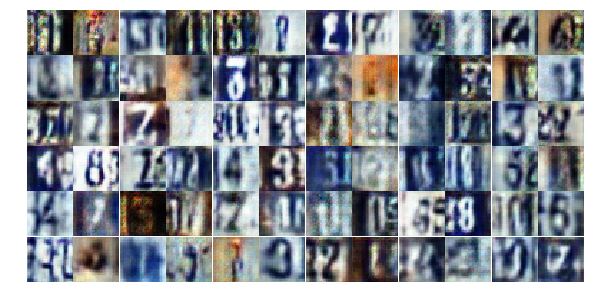

Epoch 12/100... Discriminator Loss: 1.0506... Generator Loss: 0.7843
Epoch 12/100... Discriminator Loss: 1.2542... Generator Loss: 0.6190
Epoch 12/100... Discriminator Loss: 1.3063... Generator Loss: 0.6872
Epoch 12/100... Discriminator Loss: 1.1699... Generator Loss: 0.6711


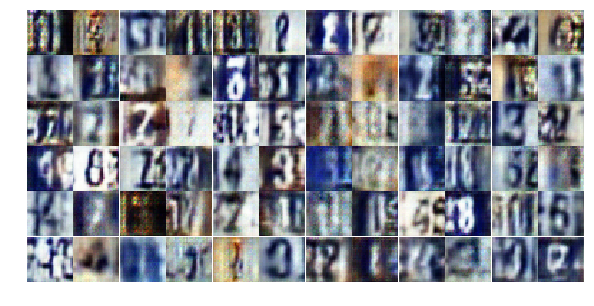

Epoch 12/100... Discriminator Loss: 1.0248... Generator Loss: 0.7183
Epoch 13/100... Discriminator Loss: 1.2003... Generator Loss: 0.7764
Epoch 13/100... Discriminator Loss: 1.1032... Generator Loss: 0.8115


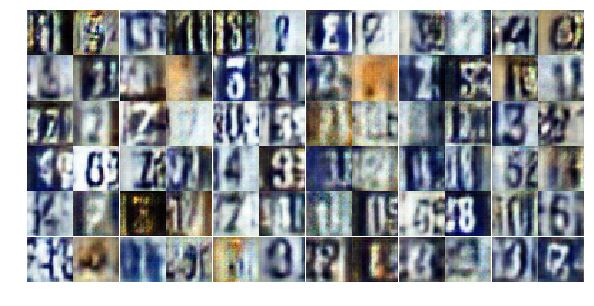

Epoch 13/100... Discriminator Loss: 1.4899... Generator Loss: 0.5938
Epoch 13/100... Discriminator Loss: 1.1982... Generator Loss: 0.6485
Epoch 13/100... Discriminator Loss: 1.1648... Generator Loss: 0.7713


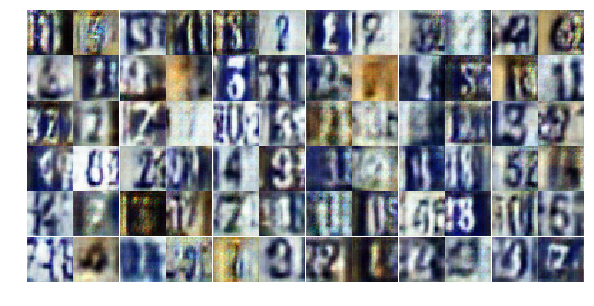

Epoch 13/100... Discriminator Loss: 1.1296... Generator Loss: 0.7531
Epoch 14/100... Discriminator Loss: 1.2996... Generator Loss: 0.6489
Epoch 14/100... Discriminator Loss: 1.4137... Generator Loss: 0.5197
Epoch 14/100... Discriminator Loss: 1.5030... Generator Loss: 0.4975


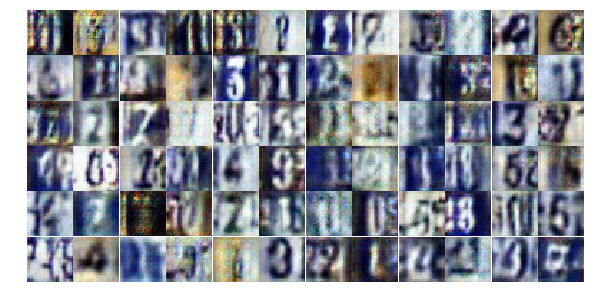

Epoch 14/100... Discriminator Loss: 1.0603... Generator Loss: 0.7439
Epoch 14/100... Discriminator Loss: 1.3180... Generator Loss: 0.6436
Epoch 14/100... Discriminator Loss: 1.3762... Generator Loss: 0.6706


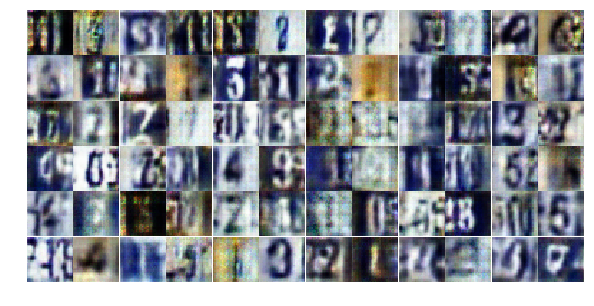

Epoch 15/100... Discriminator Loss: 1.1033... Generator Loss: 0.7899
Epoch 15/100... Discriminator Loss: 1.2166... Generator Loss: 0.5877
Epoch 15/100... Discriminator Loss: 1.0684... Generator Loss: 0.7072


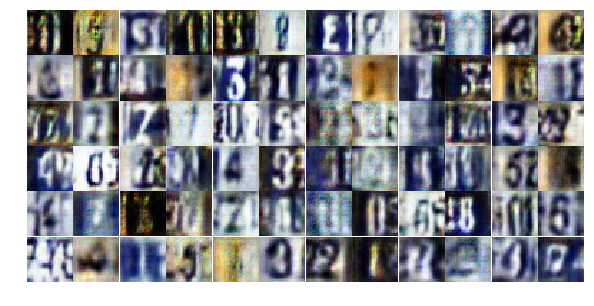

Epoch 15/100... Discriminator Loss: 0.9503... Generator Loss: 0.8274
Epoch 15/100... Discriminator Loss: 1.2184... Generator Loss: 0.6800
Epoch 15/100... Discriminator Loss: 1.2863... Generator Loss: 0.8136
Epoch 16/100... Discriminator Loss: 1.5432... Generator Loss: 0.5530


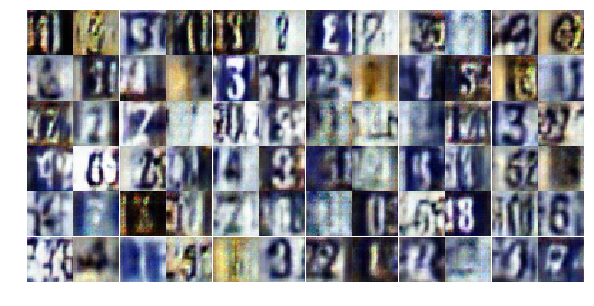

Epoch 16/100... Discriminator Loss: 1.1561... Generator Loss: 0.6848
Epoch 16/100... Discriminator Loss: 1.3282... Generator Loss: 0.6516
Epoch 16/100... Discriminator Loss: 1.1233... Generator Loss: 0.7009


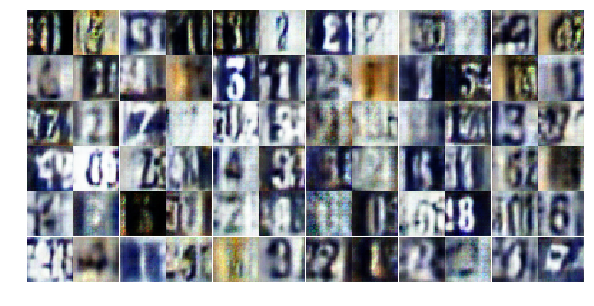

Epoch 16/100... Discriminator Loss: 1.3121... Generator Loss: 0.6634
Epoch 16/100... Discriminator Loss: 1.4100... Generator Loss: 0.6270
Epoch 17/100... Discriminator Loss: 1.0957... Generator Loss: 0.6666


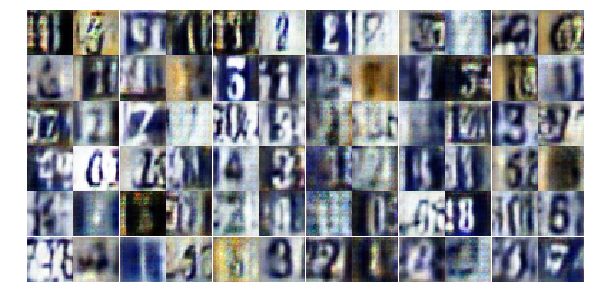

Epoch 17/100... Discriminator Loss: 1.5910... Generator Loss: 0.5054
Epoch 17/100... Discriminator Loss: 1.3877... Generator Loss: 0.6217
Epoch 17/100... Discriminator Loss: 1.3942... Generator Loss: 0.5689
Epoch 17/100... Discriminator Loss: 0.7753... Generator Loss: 0.9154


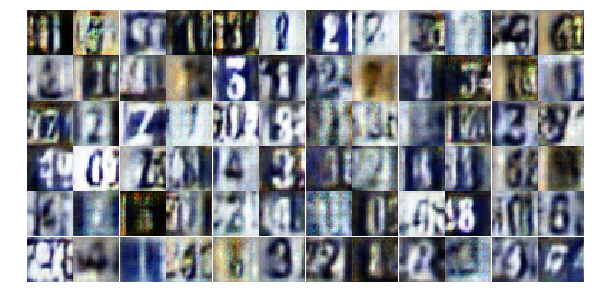

Epoch 17/100... Discriminator Loss: 1.3119... Generator Loss: 0.6545
Epoch 18/100... Discriminator Loss: 1.5610... Generator Loss: 0.4839
Epoch 18/100... Discriminator Loss: 1.3799... Generator Loss: 0.5684


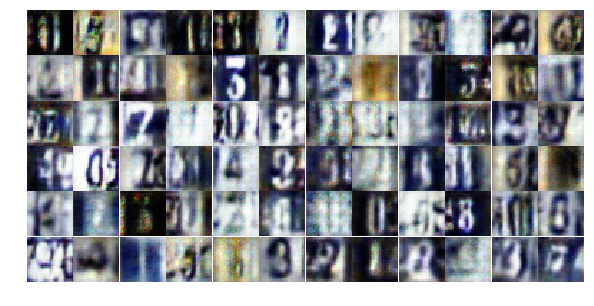

Epoch 18/100... Discriminator Loss: 1.1611... Generator Loss: 0.8019
Epoch 18/100... Discriminator Loss: 1.0393... Generator Loss: 0.6137
Epoch 18/100... Discriminator Loss: 1.2721... Generator Loss: 0.6683


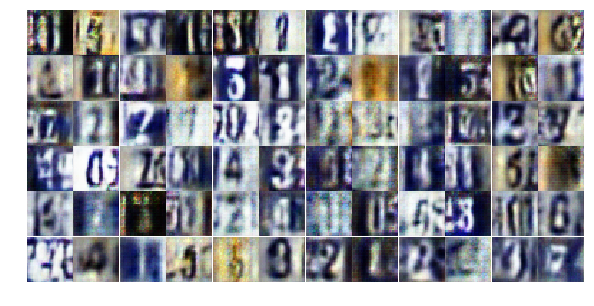

Epoch 18/100... Discriminator Loss: 1.0458... Generator Loss: 1.0627
Epoch 19/100... Discriminator Loss: 1.2182... Generator Loss: 0.7116
Epoch 19/100... Discriminator Loss: 1.1840... Generator Loss: 0.9058
Epoch 19/100... Discriminator Loss: 1.2888... Generator Loss: 0.6132


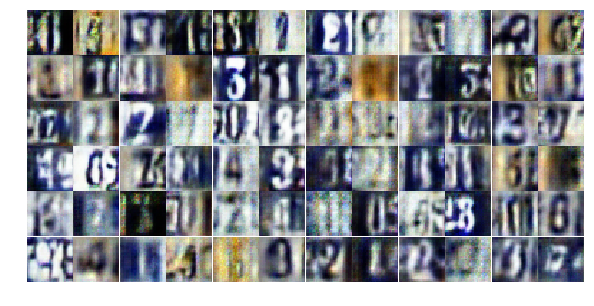

Epoch 19/100... Discriminator Loss: 1.2709... Generator Loss: 0.6347
Epoch 19/100... Discriminator Loss: 1.1454... Generator Loss: 0.8139
Epoch 19/100... Discriminator Loss: 1.2311... Generator Loss: 0.7178


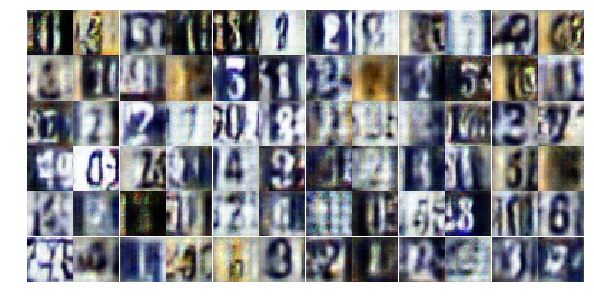

Epoch 20/100... Discriminator Loss: 1.1562... Generator Loss: 0.7203
Epoch 20/100... Discriminator Loss: 1.1579... Generator Loss: 0.7873
Epoch 20/100... Discriminator Loss: 1.2188... Generator Loss: 0.9268


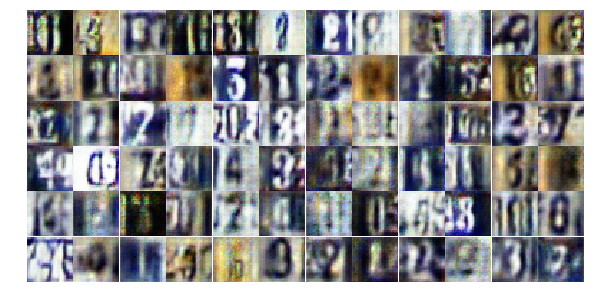

Epoch 20/100... Discriminator Loss: 1.4183... Generator Loss: 0.5486
Epoch 20/100... Discriminator Loss: 1.3929... Generator Loss: 0.6685
Epoch 20/100... Discriminator Loss: 1.4598... Generator Loss: 0.5304
Epoch 21/100... Discriminator Loss: 1.2345... Generator Loss: 0.6717


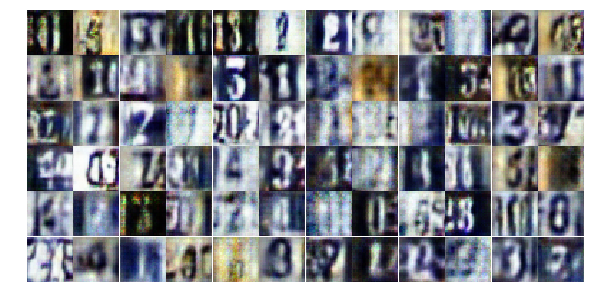

Epoch 21/100... Discriminator Loss: 1.1851... Generator Loss: 0.6605
Epoch 21/100... Discriminator Loss: 1.1751... Generator Loss: 0.7557
Epoch 21/100... Discriminator Loss: 1.1520... Generator Loss: 0.7097


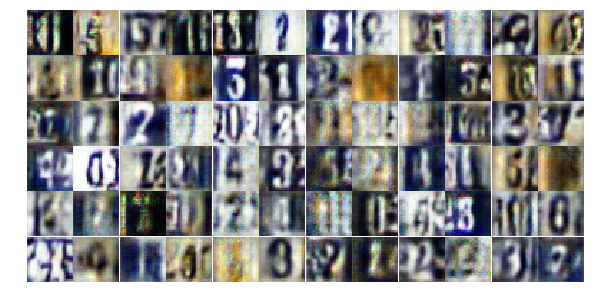

Epoch 21/100... Discriminator Loss: 0.9873... Generator Loss: 0.7534
Epoch 21/100... Discriminator Loss: 1.4226... Generator Loss: 0.5864
Epoch 22/100... Discriminator Loss: 1.2897... Generator Loss: 0.7039


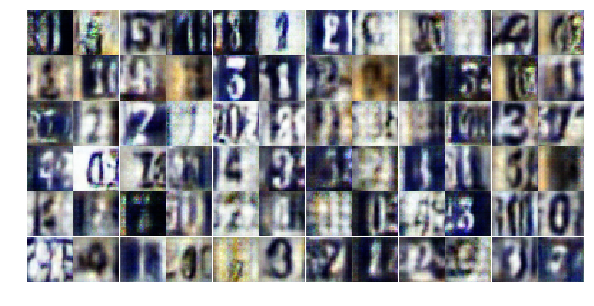

Epoch 22/100... Discriminator Loss: 1.0748... Generator Loss: 0.6483
Epoch 22/100... Discriminator Loss: 1.0153... Generator Loss: 0.8265
Epoch 22/100... Discriminator Loss: 0.9659... Generator Loss: 0.7603
Epoch 22/100... Discriminator Loss: 1.4258... Generator Loss: 0.5627


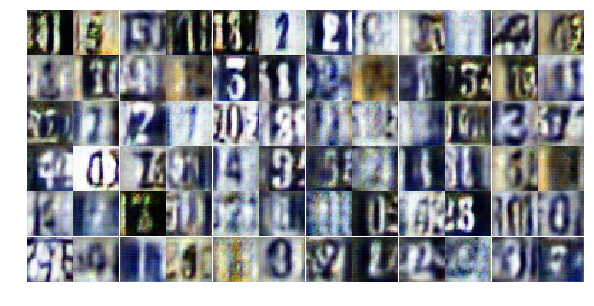

Epoch 22/100... Discriminator Loss: 1.5222... Generator Loss: 0.6201
Epoch 23/100... Discriminator Loss: 1.1913... Generator Loss: 0.7602
Epoch 23/100... Discriminator Loss: 1.9323... Generator Loss: 0.5022


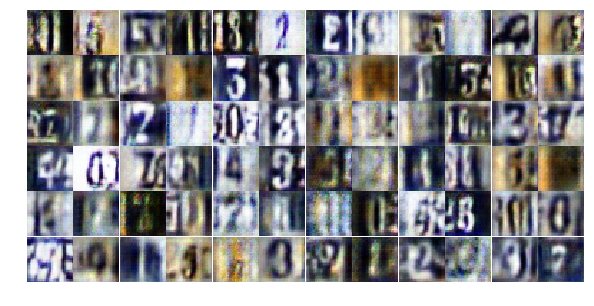

Epoch 23/100... Discriminator Loss: 1.3171... Generator Loss: 0.5869
Epoch 23/100... Discriminator Loss: 1.7993... Generator Loss: 0.6508
Epoch 23/100... Discriminator Loss: 1.2926... Generator Loss: 0.6802


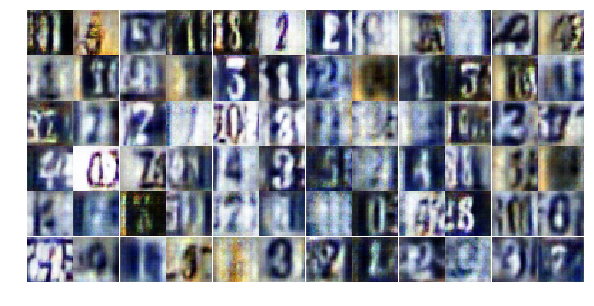

Epoch 23/100... Discriminator Loss: 1.1109... Generator Loss: 0.8057
Epoch 24/100... Discriminator Loss: 0.7352... Generator Loss: 1.1018
Epoch 24/100... Discriminator Loss: 0.9790... Generator Loss: 0.7398
Epoch 24/100... Discriminator Loss: 1.1782... Generator Loss: 0.7745


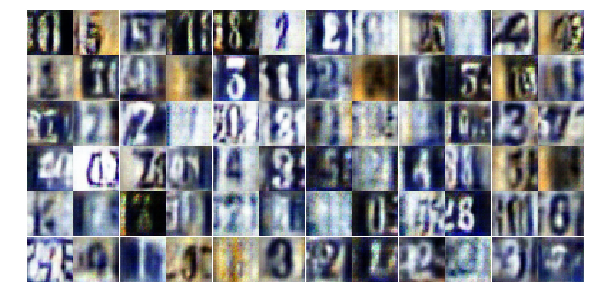

Epoch 24/100... Discriminator Loss: 1.4756... Generator Loss: 0.6830
Epoch 24/100... Discriminator Loss: 1.1415... Generator Loss: 0.6949
Epoch 24/100... Discriminator Loss: 1.1355... Generator Loss: 0.6814


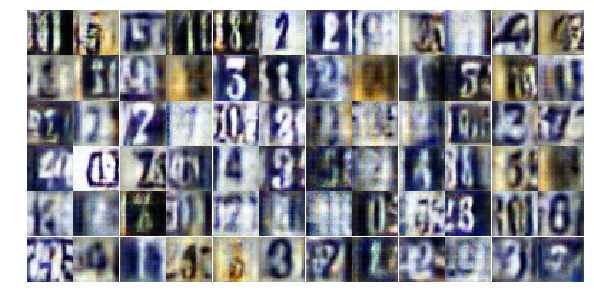

Epoch 25/100... Discriminator Loss: 1.2800... Generator Loss: 0.6572
Epoch 25/100... Discriminator Loss: 1.7773... Generator Loss: 0.4755
Epoch 25/100... Discriminator Loss: 1.0975... Generator Loss: 0.7918


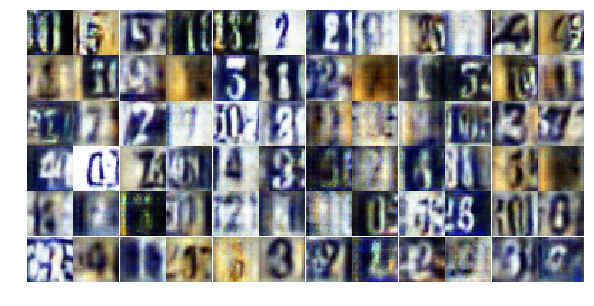

Epoch 25/100... Discriminator Loss: 1.4069... Generator Loss: 0.6715
Epoch 25/100... Discriminator Loss: 1.4946... Generator Loss: 0.7163
Epoch 25/100... Discriminator Loss: 0.8177... Generator Loss: 0.7588
Epoch 26/100... Discriminator Loss: 1.1467... Generator Loss: 0.8166


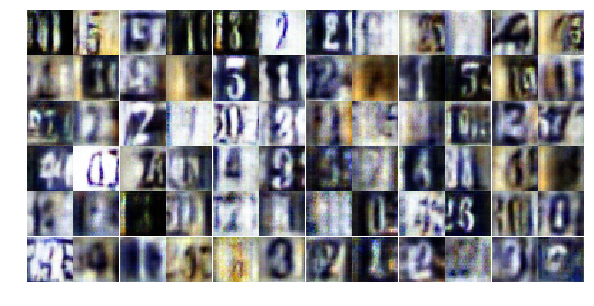

Epoch 26/100... Discriminator Loss: 1.7325... Generator Loss: 0.5100
Epoch 26/100... Discriminator Loss: 1.4410... Generator Loss: 0.6580
Epoch 26/100... Discriminator Loss: 1.9333... Generator Loss: 0.5221


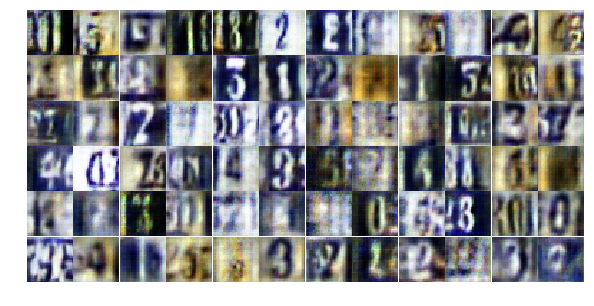

Epoch 26/100... Discriminator Loss: 1.3662... Generator Loss: 0.5572
Epoch 26/100... Discriminator Loss: 1.1492... Generator Loss: 0.5963
Epoch 27/100... Discriminator Loss: 1.2676... Generator Loss: 0.8006


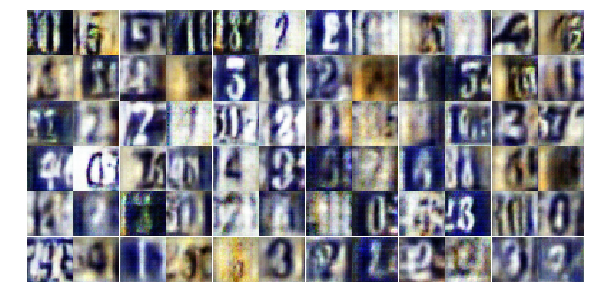

Epoch 27/100... Discriminator Loss: 1.5054... Generator Loss: 0.6713
Epoch 27/100... Discriminator Loss: 1.1618... Generator Loss: 0.6236
Epoch 27/100... Discriminator Loss: 0.9871... Generator Loss: 0.8317
Epoch 27/100... Discriminator Loss: 1.3425... Generator Loss: 0.6203


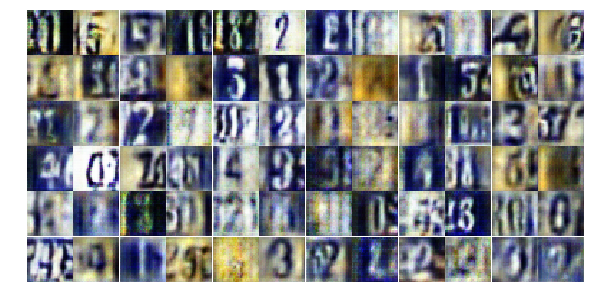

Epoch 27/100... Discriminator Loss: 1.4174... Generator Loss: 0.6581
Epoch 28/100... Discriminator Loss: 0.7445... Generator Loss: 1.0222
Epoch 28/100... Discriminator Loss: 1.1204... Generator Loss: 0.6967


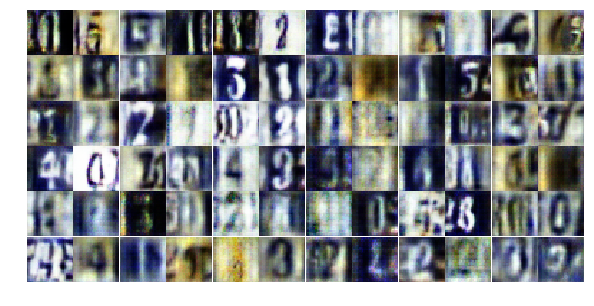

Epoch 28/100... Discriminator Loss: 1.5522... Generator Loss: 0.5777
Epoch 28/100... Discriminator Loss: 0.9991... Generator Loss: 0.5995
Epoch 28/100... Discriminator Loss: 2.0445... Generator Loss: 0.4811


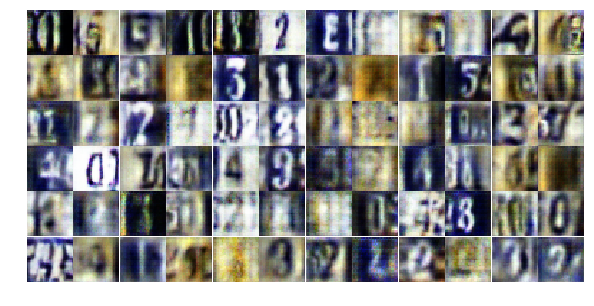

Epoch 29/100... Discriminator Loss: 0.9926... Generator Loss: 0.6143
Epoch 29/100... Discriminator Loss: 1.3847... Generator Loss: 0.6306
Epoch 29/100... Discriminator Loss: 0.7473... Generator Loss: 0.8947
Epoch 29/100... Discriminator Loss: 1.1847... Generator Loss: 0.7526


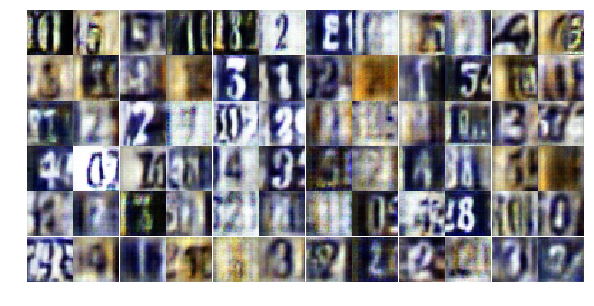

Epoch 29/100... Discriminator Loss: 0.7177... Generator Loss: 0.7882
Epoch 29/100... Discriminator Loss: 1.2834... Generator Loss: 0.6951
Epoch 30/100... Discriminator Loss: 1.1984... Generator Loss: 0.6665


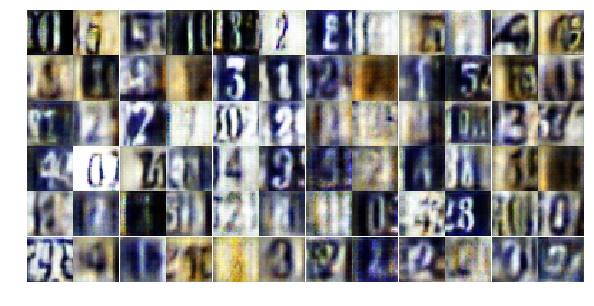

Epoch 30/100... Discriminator Loss: 1.0817... Generator Loss: 0.5675
Epoch 30/100... Discriminator Loss: 1.4292... Generator Loss: 0.8401
Epoch 30/100... Discriminator Loss: 0.8873... Generator Loss: 0.8487


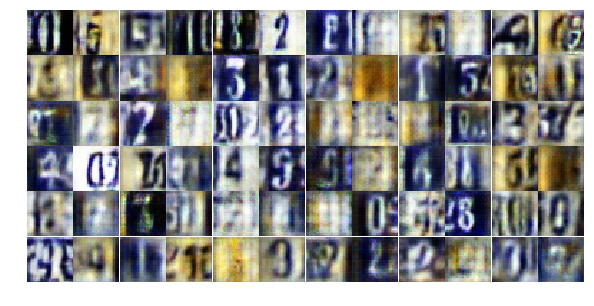

Epoch 30/100... Discriminator Loss: 1.4168... Generator Loss: 0.5328
Epoch 30/100... Discriminator Loss: 1.9103... Generator Loss: 0.3853
Epoch 31/100... Discriminator Loss: 1.0917... Generator Loss: 0.6534
Epoch 31/100... Discriminator Loss: 1.3997... Generator Loss: 0.7483


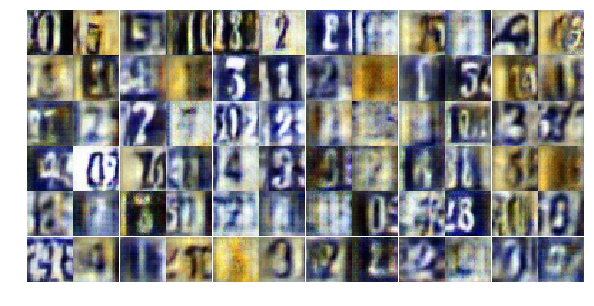

Epoch 31/100... Discriminator Loss: 1.3228... Generator Loss: 0.8736
Epoch 31/100... Discriminator Loss: 1.1879... Generator Loss: 0.8452
Epoch 31/100... Discriminator Loss: 1.2827... Generator Loss: 0.6226


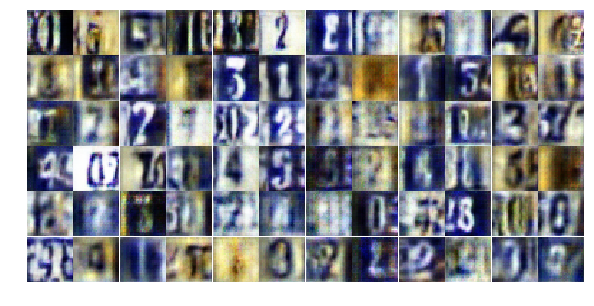

Epoch 31/100... Discriminator Loss: 2.1021... Generator Loss: 0.3742
Epoch 32/100... Discriminator Loss: 1.4317... Generator Loss: 0.6608
Epoch 32/100... Discriminator Loss: 1.1870... Generator Loss: 0.6858


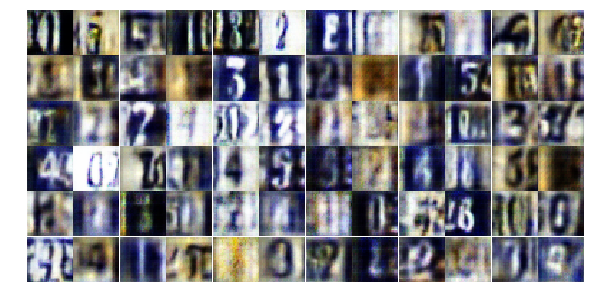

Epoch 32/100... Discriminator Loss: 1.0224... Generator Loss: 0.8029
Epoch 32/100... Discriminator Loss: 1.4499... Generator Loss: 0.5450
Epoch 32/100... Discriminator Loss: 1.1044... Generator Loss: 0.7955
Epoch 32/100... Discriminator Loss: 1.0343... Generator Loss: 0.8249


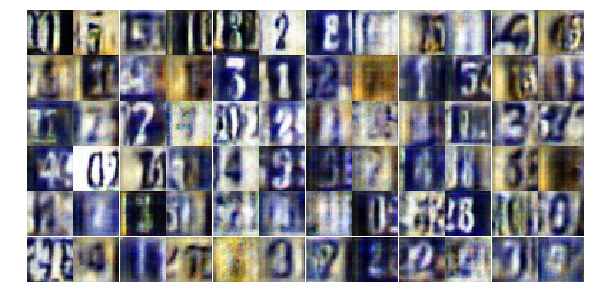

Epoch 33/100... Discriminator Loss: 0.7730... Generator Loss: 0.7704
Epoch 33/100... Discriminator Loss: 1.4312... Generator Loss: 0.5449
Epoch 33/100... Discriminator Loss: 1.1237... Generator Loss: 0.7934


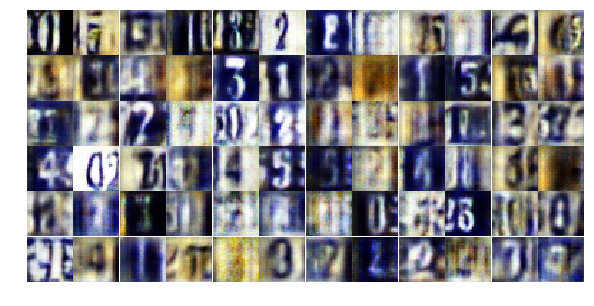

Epoch 33/100... Discriminator Loss: 1.3582... Generator Loss: 0.5204
Epoch 33/100... Discriminator Loss: 1.2396... Generator Loss: 0.6274
Epoch 33/100... Discriminator Loss: 0.8753... Generator Loss: 0.7053


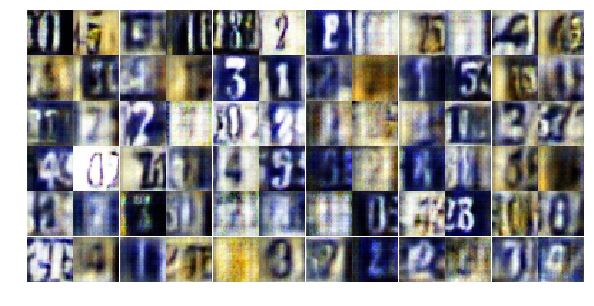

Epoch 34/100... Discriminator Loss: 0.9236... Generator Loss: 1.2029
Epoch 34/100... Discriminator Loss: 1.0236... Generator Loss: 0.7160
Epoch 34/100... Discriminator Loss: 1.0826... Generator Loss: 0.6410
Epoch 34/100... Discriminator Loss: 1.5895... Generator Loss: 0.5398


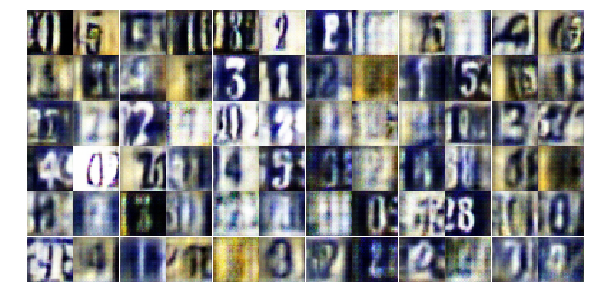

Epoch 34/100... Discriminator Loss: 1.3045... Generator Loss: 0.6785
Epoch 34/100... Discriminator Loss: 1.0697... Generator Loss: 0.6566
Epoch 35/100... Discriminator Loss: 0.7149... Generator Loss: 1.1172


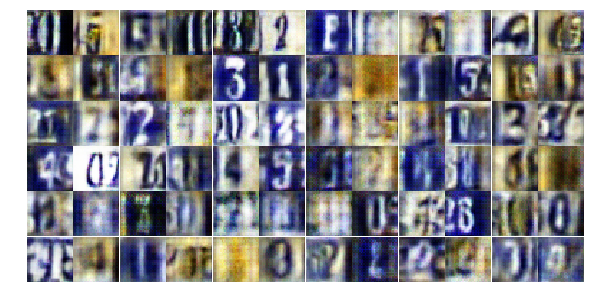

Epoch 35/100... Discriminator Loss: 1.7520... Generator Loss: 0.4509
Epoch 35/100... Discriminator Loss: 1.6567... Generator Loss: 0.6232
Epoch 35/100... Discriminator Loss: 1.0586... Generator Loss: 0.6935


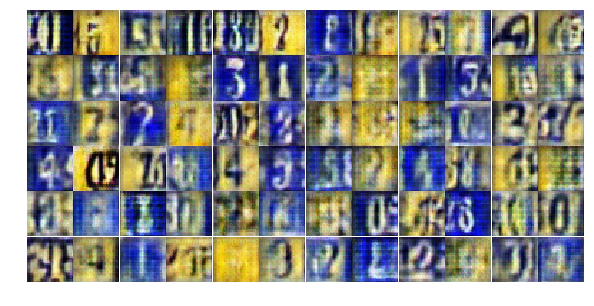

Epoch 35/100... Discriminator Loss: 0.0232... Generator Loss: 4.2537
Epoch 35/100... Discriminator Loss: 1.0769... Generator Loss: 0.9418
Epoch 36/100... Discriminator Loss: 1.2562... Generator Loss: 0.6933
Epoch 36/100... Discriminator Loss: 1.2804... Generator Loss: 0.5514


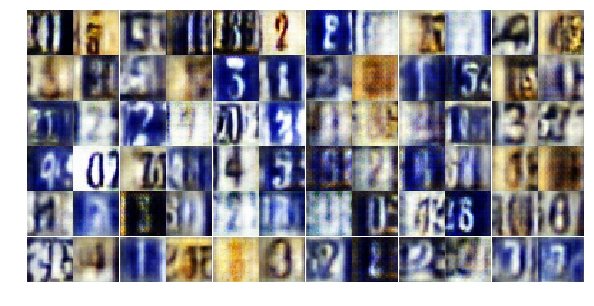

Epoch 36/100... Discriminator Loss: 1.2891... Generator Loss: 0.5976
Epoch 36/100... Discriminator Loss: 1.1709... Generator Loss: 0.6505
Epoch 36/100... Discriminator Loss: 1.3237... Generator Loss: 0.5963


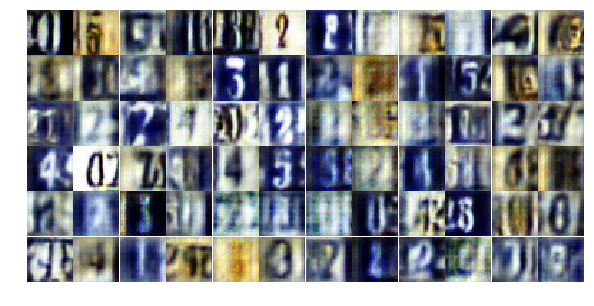

Epoch 36/100... Discriminator Loss: 1.6573... Generator Loss: 0.5865
Epoch 37/100... Discriminator Loss: 1.3431... Generator Loss: 0.5421
Epoch 37/100... Discriminator Loss: 1.0235... Generator Loss: 0.7001


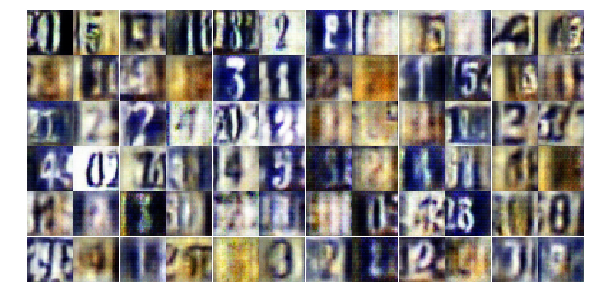

Epoch 37/100... Discriminator Loss: 1.1652... Generator Loss: 0.7602
Epoch 37/100... Discriminator Loss: 1.0474... Generator Loss: 0.8485
Epoch 37/100... Discriminator Loss: 1.2850... Generator Loss: 0.5296
Epoch 37/100... Discriminator Loss: 1.3943... Generator Loss: 0.6064


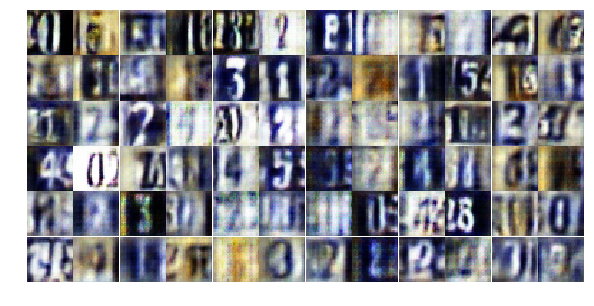

Epoch 38/100... Discriminator Loss: 1.0757... Generator Loss: 0.7392
Epoch 38/100... Discriminator Loss: 1.4424... Generator Loss: 0.6304
Epoch 38/100... Discriminator Loss: 1.3445... Generator Loss: 0.5858


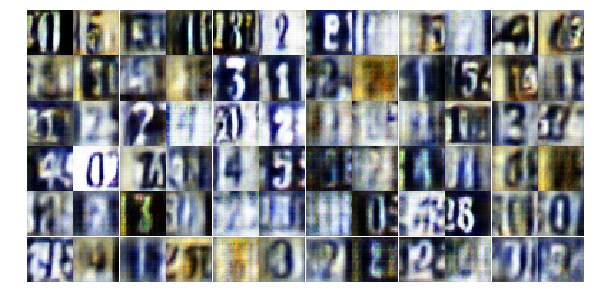

Epoch 38/100... Discriminator Loss: 1.4405... Generator Loss: 0.6620
Epoch 38/100... Discriminator Loss: 1.4693... Generator Loss: 0.5274
Epoch 38/100... Discriminator Loss: 1.3123... Generator Loss: 0.6355


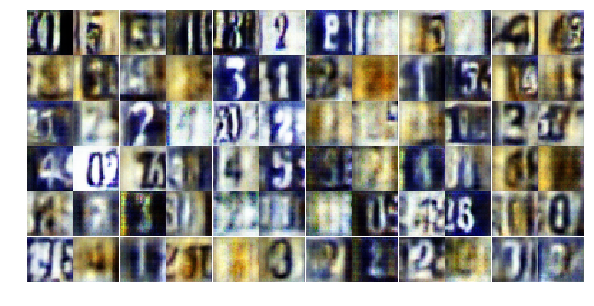

Epoch 39/100... Discriminator Loss: 1.2515... Generator Loss: 0.8391
Epoch 39/100... Discriminator Loss: 1.8318... Generator Loss: 0.4202
Epoch 39/100... Discriminator Loss: 1.4837... Generator Loss: 0.5577
Epoch 39/100... Discriminator Loss: 1.4906... Generator Loss: 0.5215


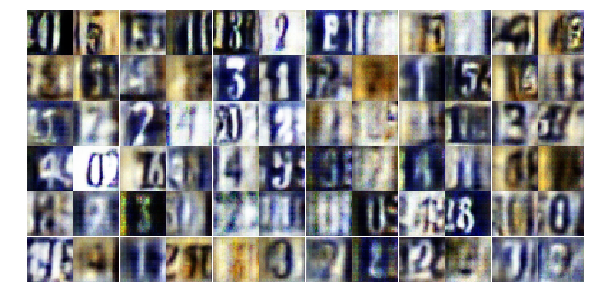

Epoch 39/100... Discriminator Loss: 0.8690... Generator Loss: 0.8230
Epoch 39/100... Discriminator Loss: 0.4910... Generator Loss: 1.0497
Epoch 40/100... Discriminator Loss: 1.4532... Generator Loss: 0.5580


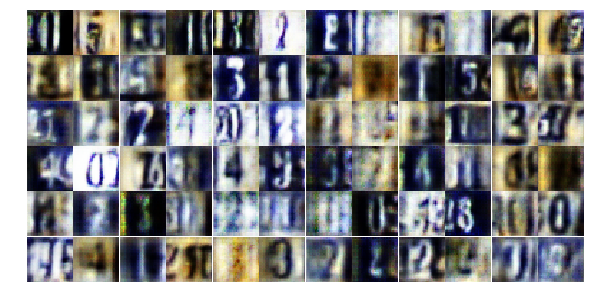

Epoch 40/100... Discriminator Loss: 1.1327... Generator Loss: 0.8603
Epoch 40/100... Discriminator Loss: 1.1711... Generator Loss: 0.9867
Epoch 40/100... Discriminator Loss: 0.9823... Generator Loss: 0.9304


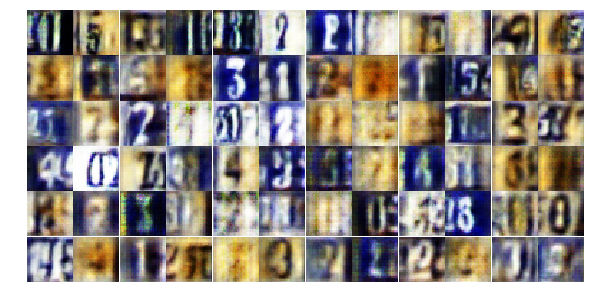

Epoch 40/100... Discriminator Loss: 1.2637... Generator Loss: 0.7035
Epoch 40/100... Discriminator Loss: 2.0999... Generator Loss: 0.3843
Epoch 41/100... Discriminator Loss: 0.8016... Generator Loss: 0.8901
Epoch 41/100... Discriminator Loss: 1.3702... Generator Loss: 0.6189


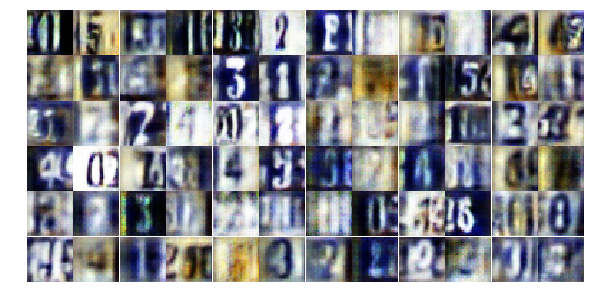

Epoch 41/100... Discriminator Loss: 1.5515... Generator Loss: 0.4983
Epoch 41/100... Discriminator Loss: 1.0712... Generator Loss: 0.7904
Epoch 41/100... Discriminator Loss: 1.5677... Generator Loss: 0.5553


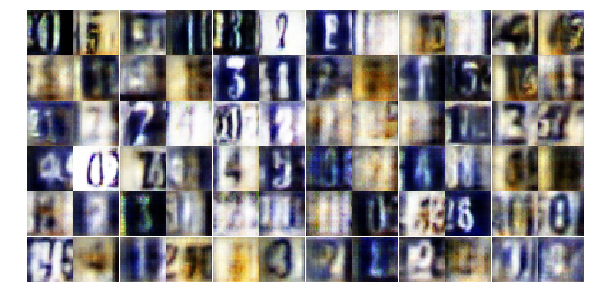

Epoch 41/100... Discriminator Loss: 1.5541... Generator Loss: 0.5457
Epoch 42/100... Discriminator Loss: 1.1477... Generator Loss: 0.7154
Epoch 42/100... Discriminator Loss: 1.7772... Generator Loss: 0.4816


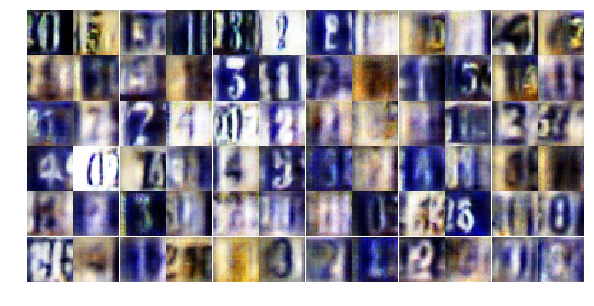

Epoch 42/100... Discriminator Loss: 1.5596... Generator Loss: 0.6703
Epoch 42/100... Discriminator Loss: 1.1784... Generator Loss: 0.6625
Epoch 42/100... Discriminator Loss: 1.7509... Generator Loss: 0.5416
Epoch 42/100... Discriminator Loss: 1.3784... Generator Loss: 0.6694


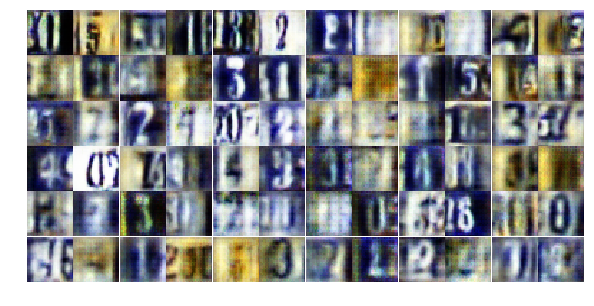

Epoch 43/100... Discriminator Loss: 1.3401... Generator Loss: 0.5907
Epoch 43/100... Discriminator Loss: 1.9171... Generator Loss: 0.3319
Epoch 43/100... Discriminator Loss: 1.0320... Generator Loss: 0.7609


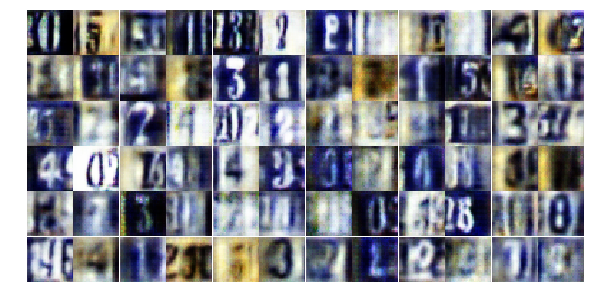

Epoch 43/100... Discriminator Loss: 2.1049... Generator Loss: 0.4553
Epoch 43/100... Discriminator Loss: 1.3857... Generator Loss: 0.7221
Epoch 43/100... Discriminator Loss: 1.5051... Generator Loss: 0.6544


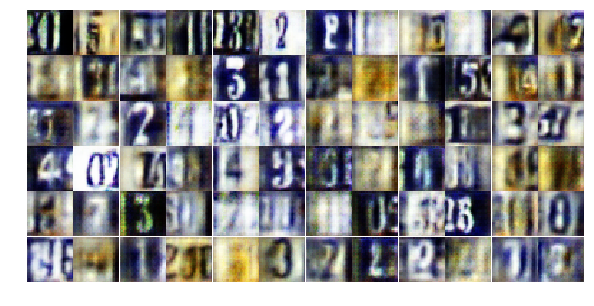

Epoch 44/100... Discriminator Loss: 0.6997... Generator Loss: 0.7754
Epoch 44/100... Discriminator Loss: 0.9002... Generator Loss: 0.6411
Epoch 44/100... Discriminator Loss: 1.3078... Generator Loss: 0.5751
Epoch 44/100... Discriminator Loss: 1.7874... Generator Loss: 0.5222


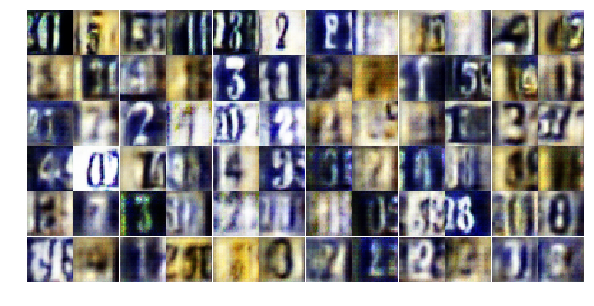

Epoch 44/100... Discriminator Loss: 1.3615... Generator Loss: 0.6878
Epoch 44/100... Discriminator Loss: 2.1247... Generator Loss: 0.3781
Epoch 45/100... Discriminator Loss: 1.7282... Generator Loss: 0.4975


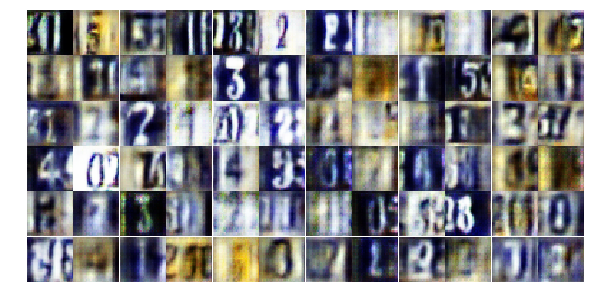

Epoch 45/100... Discriminator Loss: 1.1115... Generator Loss: 0.6851
Epoch 45/100... Discriminator Loss: 1.6206... Generator Loss: 0.5031
Epoch 45/100... Discriminator Loss: 1.3798... Generator Loss: 0.5828


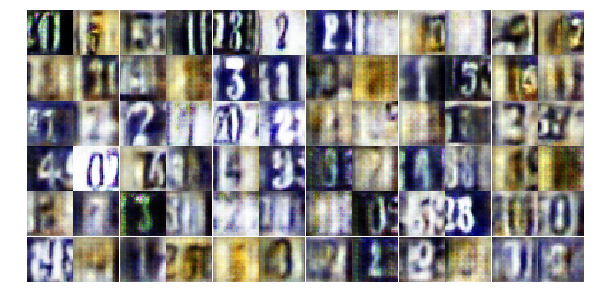

Epoch 45/100... Discriminator Loss: 2.0109... Generator Loss: 0.4260
Epoch 45/100... Discriminator Loss: 1.7482... Generator Loss: 0.5000
Epoch 46/100... Discriminator Loss: 1.3637... Generator Loss: 0.6427
Epoch 46/100... Discriminator Loss: 1.5330... Generator Loss: 0.6019


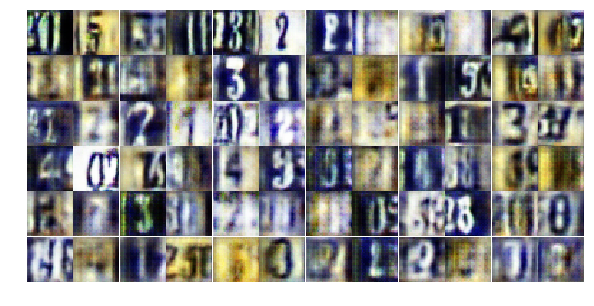

Epoch 46/100... Discriminator Loss: 1.8320... Generator Loss: 0.5241
Epoch 46/100... Discriminator Loss: 1.4170... Generator Loss: 0.7024
Epoch 46/100... Discriminator Loss: 1.0089... Generator Loss: 0.5792


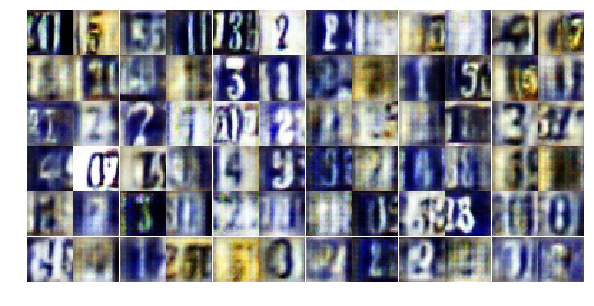

Epoch 46/100... Discriminator Loss: 0.9679... Generator Loss: 0.7772
Epoch 47/100... Discriminator Loss: 1.4788... Generator Loss: 0.6233
Epoch 47/100... Discriminator Loss: 0.7386... Generator Loss: 0.8094


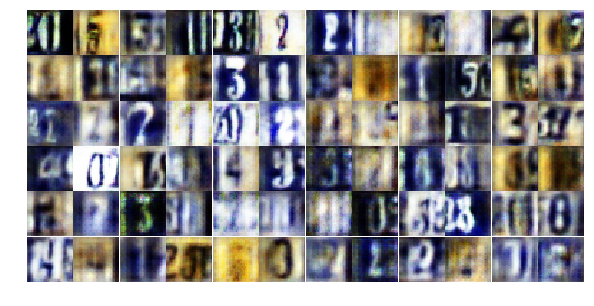

Epoch 47/100... Discriminator Loss: 1.3966... Generator Loss: 0.5923
Epoch 47/100... Discriminator Loss: 1.8884... Generator Loss: 0.4941
Epoch 47/100... Discriminator Loss: 1.1494... Generator Loss: 0.6720
Epoch 47/100... Discriminator Loss: 1.5623... Generator Loss: 0.6135


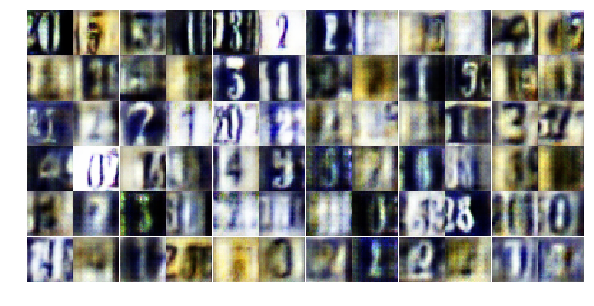

Epoch 48/100... Discriminator Loss: 1.3399... Generator Loss: 0.5447
Epoch 48/100... Discriminator Loss: 1.6398... Generator Loss: 0.6273
Epoch 48/100... Discriminator Loss: 1.6578... Generator Loss: 0.5043


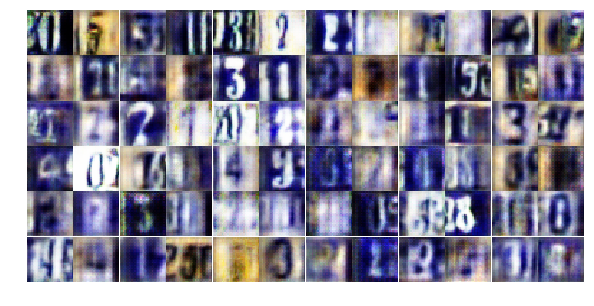

Epoch 48/100... Discriminator Loss: 0.7597... Generator Loss: 1.1359
Epoch 48/100... Discriminator Loss: 1.3445... Generator Loss: 0.7892
Epoch 48/100... Discriminator Loss: 1.3090... Generator Loss: 0.5875


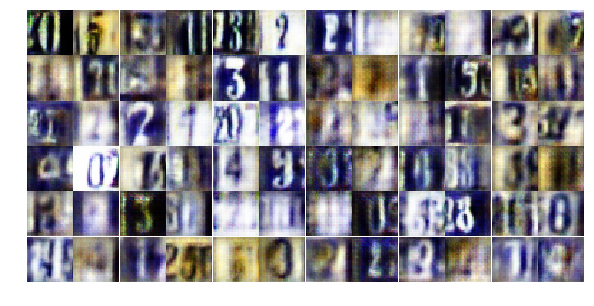

Epoch 49/100... Discriminator Loss: 1.5873... Generator Loss: 0.5362
Epoch 49/100... Discriminator Loss: 1.2370... Generator Loss: 0.6189
Epoch 49/100... Discriminator Loss: 1.6109... Generator Loss: 0.5973
Epoch 49/100... Discriminator Loss: 1.3737... Generator Loss: 0.7162


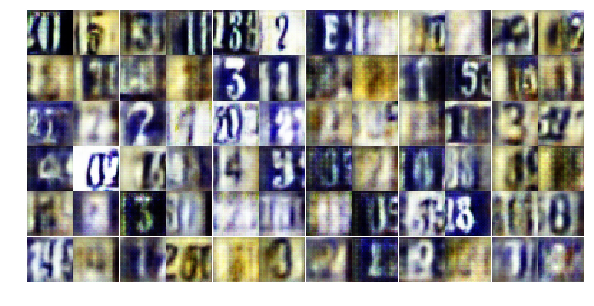

Epoch 49/100... Discriminator Loss: 1.4464... Generator Loss: 0.6056
Epoch 49/100... Discriminator Loss: 1.3640... Generator Loss: 0.6729
Epoch 50/100... Discriminator Loss: 1.3017... Generator Loss: 0.6864


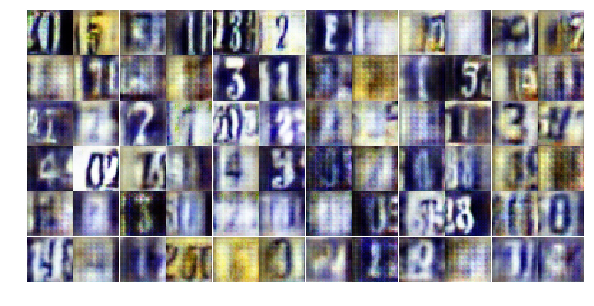

Epoch 50/100... Discriminator Loss: 1.0217... Generator Loss: 0.7888
Epoch 50/100... Discriminator Loss: 1.4359... Generator Loss: 0.5019
Epoch 50/100... Discriminator Loss: 1.5943... Generator Loss: 0.5764


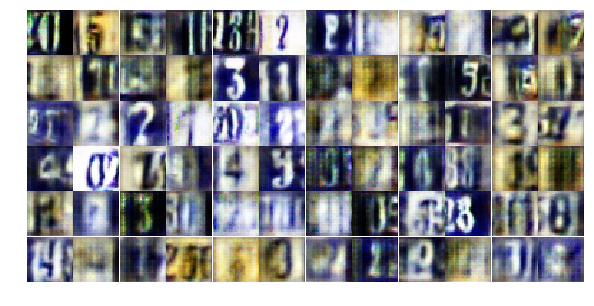

Epoch 50/100... Discriminator Loss: 1.3757... Generator Loss: 0.8016
Epoch 50/100... Discriminator Loss: 0.7190... Generator Loss: 1.0587
Epoch 51/100... Discriminator Loss: 1.6239... Generator Loss: 0.6700
Epoch 51/100... Discriminator Loss: 1.0480... Generator Loss: 0.9383


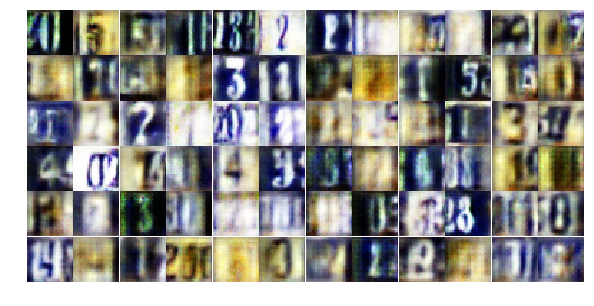

Epoch 51/100... Discriminator Loss: 0.8795... Generator Loss: 1.0570
Epoch 51/100... Discriminator Loss: 1.4287... Generator Loss: 0.6096
Epoch 51/100... Discriminator Loss: 1.6988... Generator Loss: 0.7031


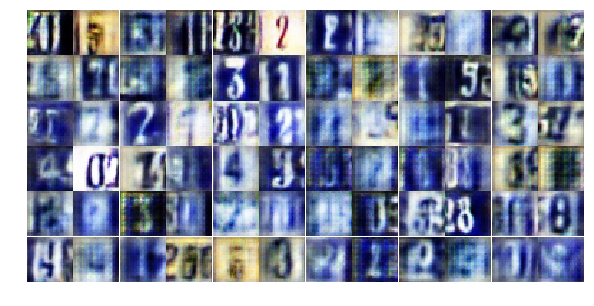

Epoch 51/100... Discriminator Loss: 1.1031... Generator Loss: 0.8256
Epoch 52/100... Discriminator Loss: 1.3365... Generator Loss: 0.5757
Epoch 52/100... Discriminator Loss: 1.9288... Generator Loss: 0.4438


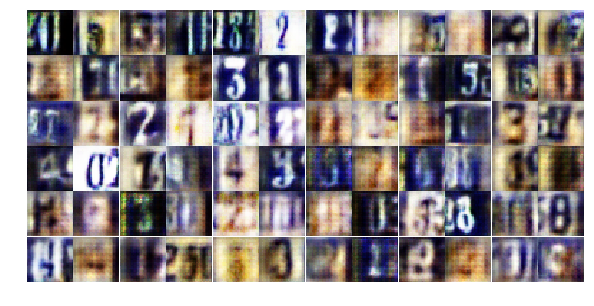

Epoch 52/100... Discriminator Loss: 1.5354... Generator Loss: 0.5397
Epoch 52/100... Discriminator Loss: 1.4474... Generator Loss: 0.6111
Epoch 52/100... Discriminator Loss: 1.3959... Generator Loss: 0.6924
Epoch 52/100... Discriminator Loss: 1.3340... Generator Loss: 0.4656


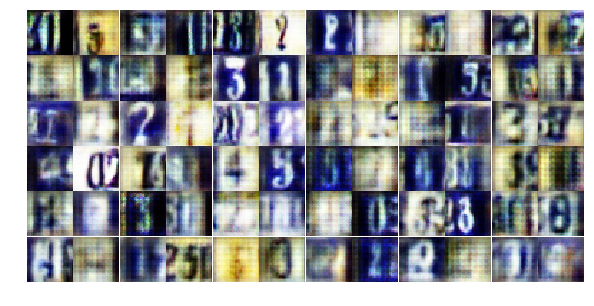

Epoch 53/100... Discriminator Loss: 1.2839... Generator Loss: 0.6246
Epoch 53/100... Discriminator Loss: 1.6331... Generator Loss: 0.4896
Epoch 53/100... Discriminator Loss: 1.3900... Generator Loss: 0.5679


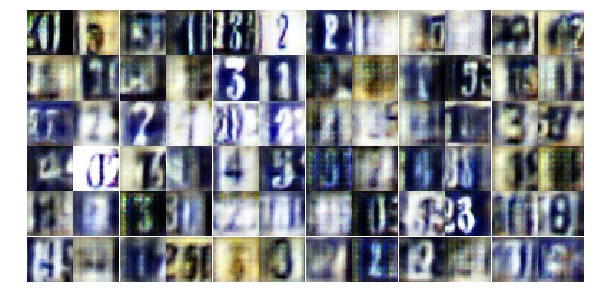

Epoch 53/100... Discriminator Loss: 1.0561... Generator Loss: 0.8615
Epoch 53/100... Discriminator Loss: 1.1984... Generator Loss: 0.6434
Epoch 53/100... Discriminator Loss: 1.2787... Generator Loss: 0.8136


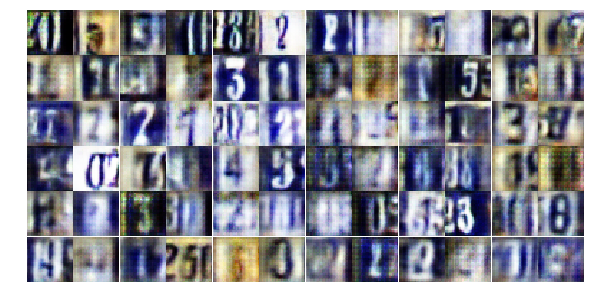

Epoch 54/100... Discriminator Loss: 1.3968... Generator Loss: 0.5976
Epoch 54/100... Discriminator Loss: 1.0945... Generator Loss: 0.8989
Epoch 54/100... Discriminator Loss: 0.9006... Generator Loss: 0.8609
Epoch 54/100... Discriminator Loss: 1.0566... Generator Loss: 0.7318


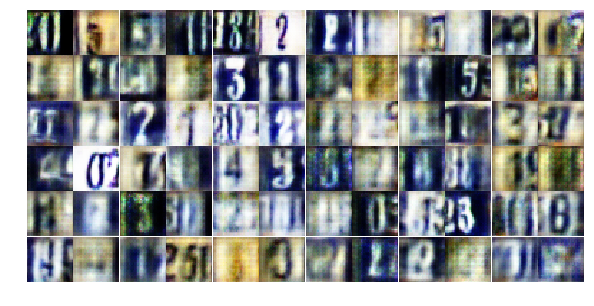

Epoch 54/100... Discriminator Loss: 1.0683... Generator Loss: 0.8331
Epoch 54/100... Discriminator Loss: 1.8341... Generator Loss: 0.6204
Epoch 55/100... Discriminator Loss: 1.1448... Generator Loss: 0.7543


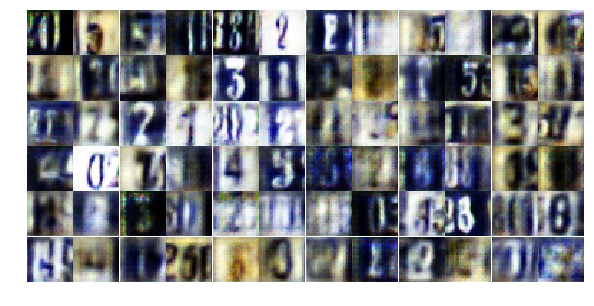

Epoch 55/100... Discriminator Loss: 1.3519... Generator Loss: 0.6209
Epoch 55/100... Discriminator Loss: 1.3066... Generator Loss: 0.7527
Epoch 55/100... Discriminator Loss: 1.3665... Generator Loss: 0.7312


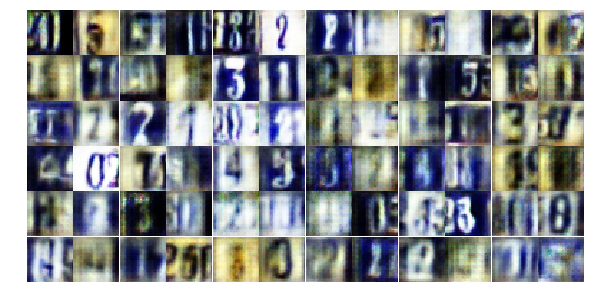

Epoch 55/100... Discriminator Loss: 1.1599... Generator Loss: 0.8054
Epoch 56/100... Discriminator Loss: 1.5636... Generator Loss: 0.5643
Epoch 56/100... Discriminator Loss: 1.4090... Generator Loss: 0.5709
Epoch 56/100... Discriminator Loss: 2.1160... Generator Loss: 0.4884


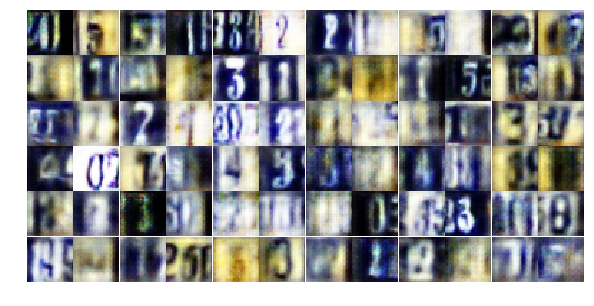

Epoch 56/100... Discriminator Loss: 1.2642... Generator Loss: 0.6013
Epoch 56/100... Discriminator Loss: 1.3088... Generator Loss: 0.6804
Epoch 56/100... Discriminator Loss: 1.0743... Generator Loss: 0.7203


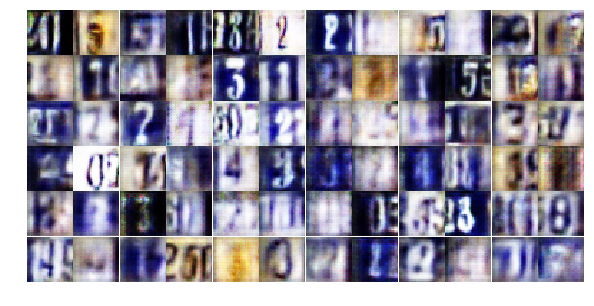

Epoch 57/100... Discriminator Loss: 0.9241... Generator Loss: 0.8669
Epoch 57/100... Discriminator Loss: 1.2928... Generator Loss: 0.5947
Epoch 57/100... Discriminator Loss: 1.0495... Generator Loss: 0.6215


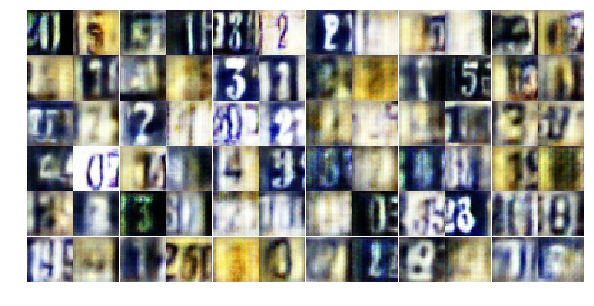

Epoch 57/100... Discriminator Loss: 1.2208... Generator Loss: 0.6220
Epoch 57/100... Discriminator Loss: 1.4833... Generator Loss: 0.5790
Epoch 57/100... Discriminator Loss: 1.2875... Generator Loss: 0.7197
Epoch 58/100... Discriminator Loss: 1.1420... Generator Loss: 0.7658


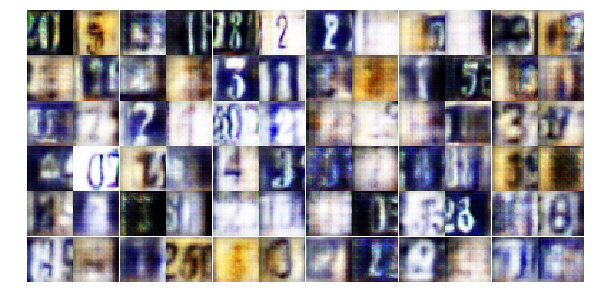

Epoch 58/100... Discriminator Loss: 1.3409... Generator Loss: 0.6038
Epoch 58/100... Discriminator Loss: 1.3358... Generator Loss: 0.6513
Epoch 58/100... Discriminator Loss: 1.0514... Generator Loss: 0.6618


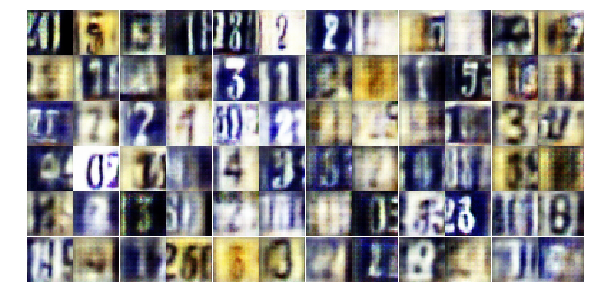

Epoch 58/100... Discriminator Loss: 1.4307... Generator Loss: 0.6369
Epoch 58/100... Discriminator Loss: 1.1710... Generator Loss: 0.6119
Epoch 59/100... Discriminator Loss: 1.2713... Generator Loss: 0.7075


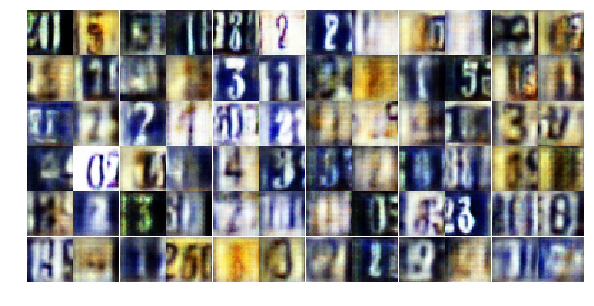

Epoch 59/100... Discriminator Loss: 1.2767... Generator Loss: 0.7923
Epoch 59/100... Discriminator Loss: 1.6390... Generator Loss: 0.6332
Epoch 59/100... Discriminator Loss: 1.5009... Generator Loss: 0.6212
Epoch 59/100... Discriminator Loss: 1.4142... Generator Loss: 0.6831


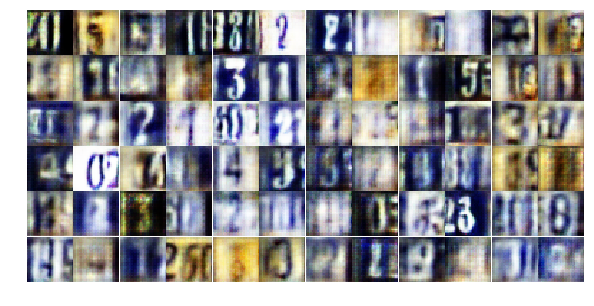

Epoch 59/100... Discriminator Loss: 1.9469... Generator Loss: 0.4026
Epoch 60/100... Discriminator Loss: 1.2335... Generator Loss: 0.6200
Epoch 60/100... Discriminator Loss: 1.3953... Generator Loss: 0.5942


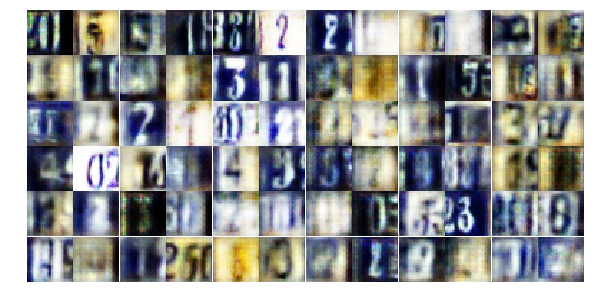

Epoch 60/100... Discriminator Loss: 1.0086... Generator Loss: 0.6914
Epoch 60/100... Discriminator Loss: 1.0431... Generator Loss: 0.7528
Epoch 60/100... Discriminator Loss: 1.4350... Generator Loss: 0.5302


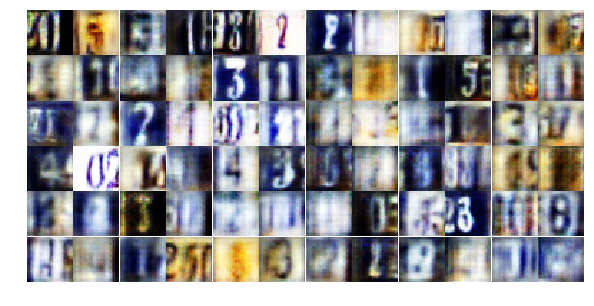

Epoch 60/100... Discriminator Loss: 1.1514... Generator Loss: 0.6325
Epoch 61/100... Discriminator Loss: 1.6765... Generator Loss: 0.4822
Epoch 61/100... Discriminator Loss: 1.6610... Generator Loss: 0.6129
Epoch 61/100... Discriminator Loss: 1.3178... Generator Loss: 0.6580


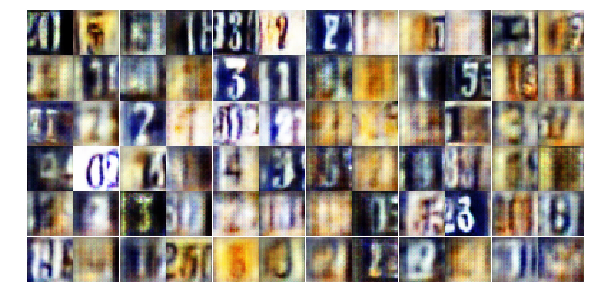

Epoch 61/100... Discriminator Loss: 1.2132... Generator Loss: 0.7298
Epoch 61/100... Discriminator Loss: 1.0881... Generator Loss: 0.7145
Epoch 61/100... Discriminator Loss: 1.3721... Generator Loss: 0.6795


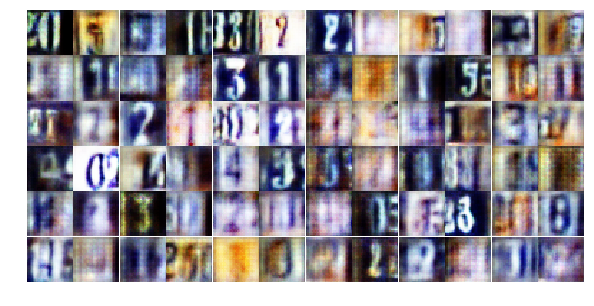

Epoch 62/100... Discriminator Loss: 1.4421... Generator Loss: 0.5216
Epoch 62/100... Discriminator Loss: 1.3281... Generator Loss: 0.5864
Epoch 62/100... Discriminator Loss: 1.4222... Generator Loss: 0.5568


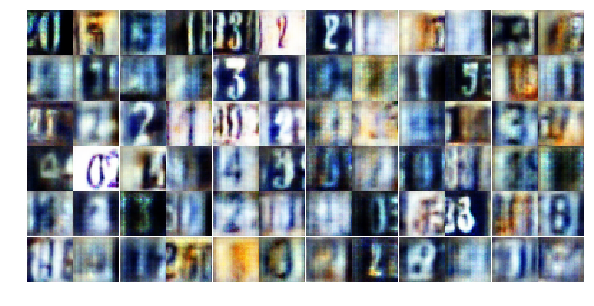

Epoch 62/100... Discriminator Loss: 1.4390... Generator Loss: 0.5684
Epoch 62/100... Discriminator Loss: 1.3583... Generator Loss: 0.7489
Epoch 62/100... Discriminator Loss: 1.6794... Generator Loss: 0.5203
Epoch 63/100... Discriminator Loss: 1.6375... Generator Loss: 0.5195


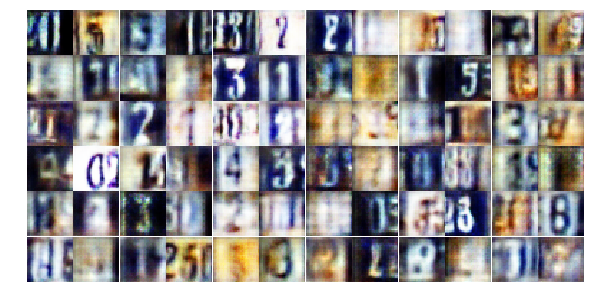

Epoch 63/100... Discriminator Loss: 1.2483... Generator Loss: 0.7466
Epoch 63/100... Discriminator Loss: 1.4005... Generator Loss: 0.6473
Epoch 63/100... Discriminator Loss: 0.8943... Generator Loss: 0.8646


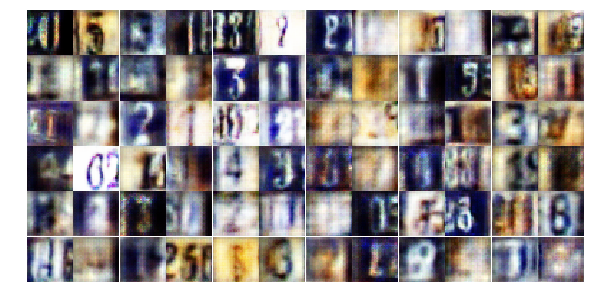

Epoch 63/100... Discriminator Loss: 1.5939... Generator Loss: 0.5549
Epoch 63/100... Discriminator Loss: 1.3158... Generator Loss: 0.6492
Epoch 64/100... Discriminator Loss: 1.3713... Generator Loss: 0.6580


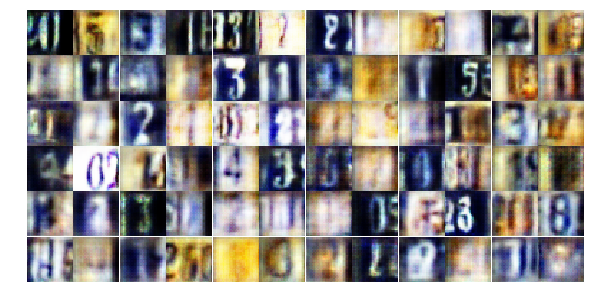

Epoch 64/100... Discriminator Loss: 1.5291... Generator Loss: 0.5590
Epoch 64/100... Discriminator Loss: 1.8971... Generator Loss: 0.5897
Epoch 64/100... Discriminator Loss: 1.5319... Generator Loss: 0.4459
Epoch 64/100... Discriminator Loss: 1.3682... Generator Loss: 0.6968


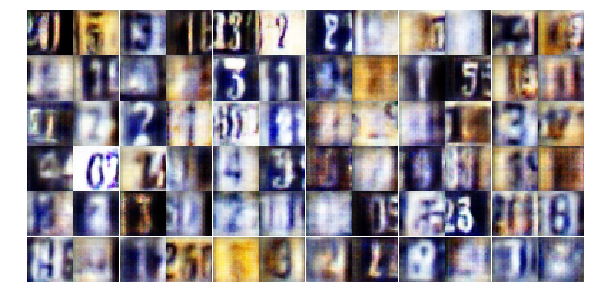

Epoch 64/100... Discriminator Loss: 1.2528... Generator Loss: 0.7399
Epoch 65/100... Discriminator Loss: 1.2347... Generator Loss: 0.7066
Epoch 65/100... Discriminator Loss: 1.4229... Generator Loss: 0.5960


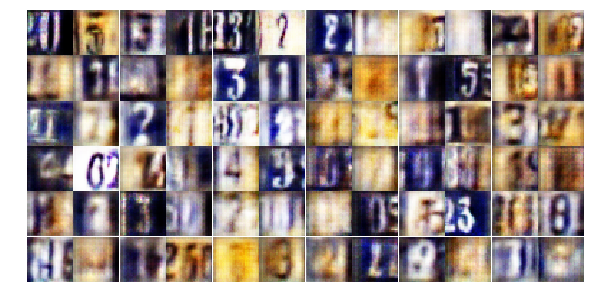

Epoch 65/100... Discriminator Loss: 0.9731... Generator Loss: 0.8814
Epoch 65/100... Discriminator Loss: 1.3753... Generator Loss: 0.6470
Epoch 65/100... Discriminator Loss: 1.4188... Generator Loss: 0.4846


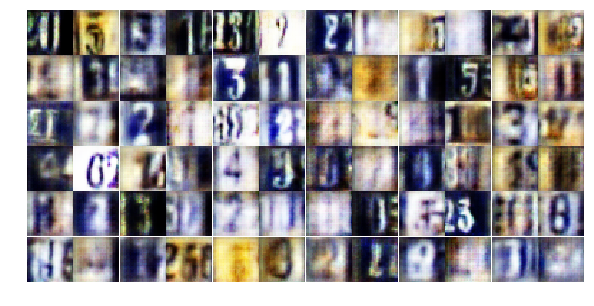

Epoch 65/100... Discriminator Loss: 1.3795... Generator Loss: 0.6453
Epoch 66/100... Discriminator Loss: 1.1724... Generator Loss: 0.7413
Epoch 66/100... Discriminator Loss: 1.1453... Generator Loss: 0.6505
Epoch 66/100... Discriminator Loss: 1.4157... Generator Loss: 0.5488


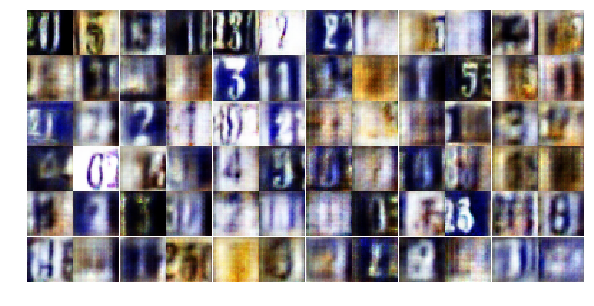

Epoch 66/100... Discriminator Loss: 1.3180... Generator Loss: 0.6674
Epoch 66/100... Discriminator Loss: 1.4312... Generator Loss: 0.6273
Epoch 66/100... Discriminator Loss: 1.4972... Generator Loss: 0.5824


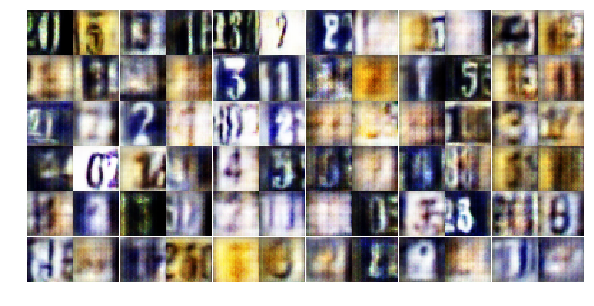

Epoch 67/100... Discriminator Loss: 1.5009... Generator Loss: 0.6990
Epoch 67/100... Discriminator Loss: 1.2312... Generator Loss: 0.7012
Epoch 67/100... Discriminator Loss: 1.3795... Generator Loss: 0.5844


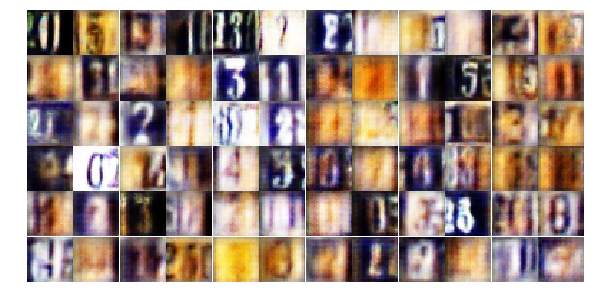

Epoch 67/100... Discriminator Loss: 1.4613... Generator Loss: 0.6442
Epoch 67/100... Discriminator Loss: 1.5744... Generator Loss: 0.5305
Epoch 67/100... Discriminator Loss: 1.3313... Generator Loss: 0.5791
Epoch 68/100... Discriminator Loss: 1.5597... Generator Loss: 0.5769


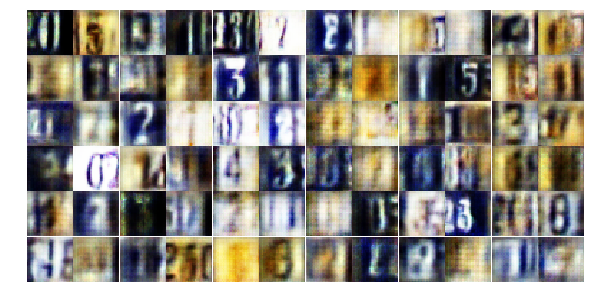

Epoch 68/100... Discriminator Loss: 1.5215... Generator Loss: 0.6180
Epoch 68/100... Discriminator Loss: 1.4002... Generator Loss: 0.7679
Epoch 68/100... Discriminator Loss: 1.3334... Generator Loss: 0.6272


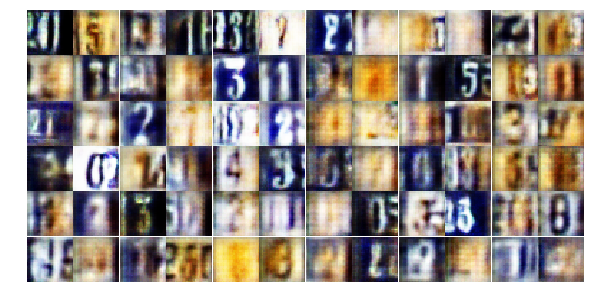

Epoch 68/100... Discriminator Loss: 1.6789... Generator Loss: 0.5654
Epoch 68/100... Discriminator Loss: 1.0775... Generator Loss: 0.9054
Epoch 69/100... Discriminator Loss: 1.5215... Generator Loss: 0.5867


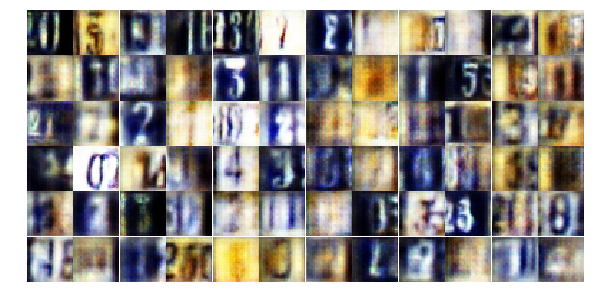

Epoch 69/100... Discriminator Loss: 1.2752... Generator Loss: 0.5661
Epoch 69/100... Discriminator Loss: 1.3773... Generator Loss: 0.6991
Epoch 69/100... Discriminator Loss: 1.2079... Generator Loss: 0.6237
Epoch 69/100... Discriminator Loss: 1.3384... Generator Loss: 0.5488


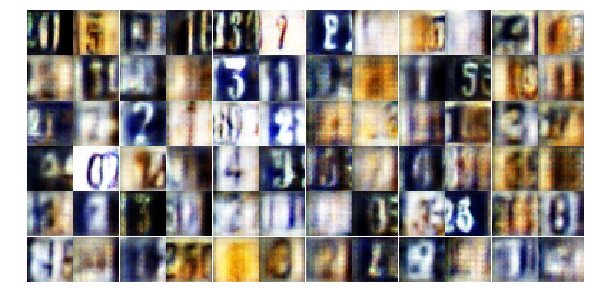

Epoch 69/100... Discriminator Loss: 1.4217... Generator Loss: 0.5652
Epoch 70/100... Discriminator Loss: 1.3587... Generator Loss: 0.5570
Epoch 70/100... Discriminator Loss: 1.1775... Generator Loss: 0.5842


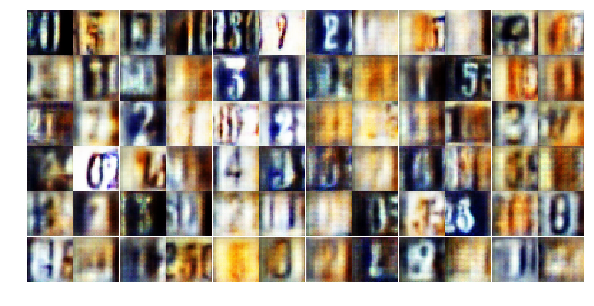

Epoch 70/100... Discriminator Loss: 1.6783... Generator Loss: 0.5438
Epoch 70/100... Discriminator Loss: 1.4266... Generator Loss: 0.5764
Epoch 70/100... Discriminator Loss: 1.2254... Generator Loss: 0.6537


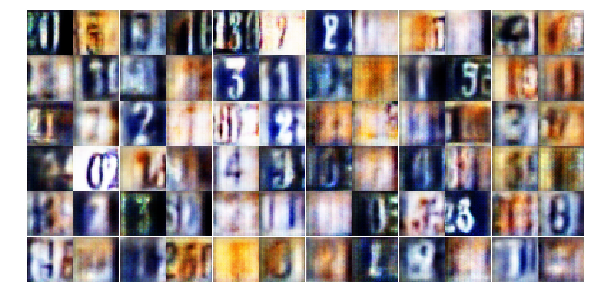

Epoch 70/100... Discriminator Loss: 1.2946... Generator Loss: 0.6205
Epoch 71/100... Discriminator Loss: 1.3053... Generator Loss: 0.5667
Epoch 71/100... Discriminator Loss: 1.2586... Generator Loss: 0.6400
Epoch 71/100... Discriminator Loss: 1.0166... Generator Loss: 0.6680


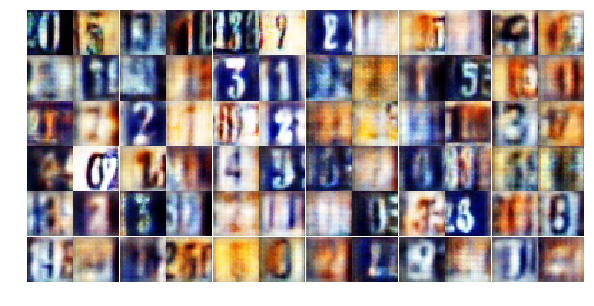

Epoch 71/100... Discriminator Loss: 1.2106... Generator Loss: 0.8283
Epoch 71/100... Discriminator Loss: 1.6214... Generator Loss: 0.5327
Epoch 71/100... Discriminator Loss: 1.4640... Generator Loss: 0.5851


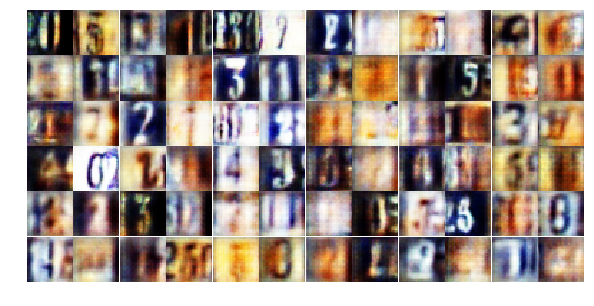

Epoch 72/100... Discriminator Loss: 1.3087... Generator Loss: 0.6269
Epoch 72/100... Discriminator Loss: 1.7316... Generator Loss: 0.5831
Epoch 72/100... Discriminator Loss: 0.9896... Generator Loss: 0.7609


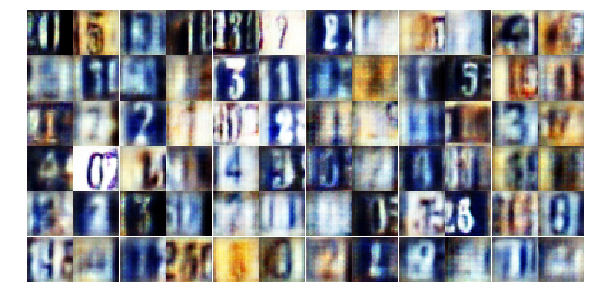

Epoch 72/100... Discriminator Loss: 1.4309... Generator Loss: 0.5947
Epoch 72/100... Discriminator Loss: 1.2276... Generator Loss: 0.6968
Epoch 72/100... Discriminator Loss: 1.4231... Generator Loss: 0.5940
Epoch 73/100... Discriminator Loss: 1.4468... Generator Loss: 0.6639


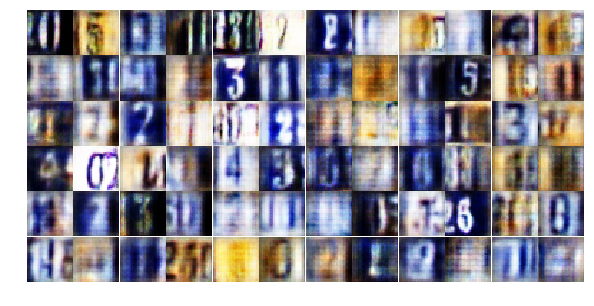

Epoch 73/100... Discriminator Loss: 1.3989... Generator Loss: 0.6786
Epoch 73/100... Discriminator Loss: 1.1108... Generator Loss: 0.8958
Epoch 73/100... Discriminator Loss: 1.0786... Generator Loss: 0.7365


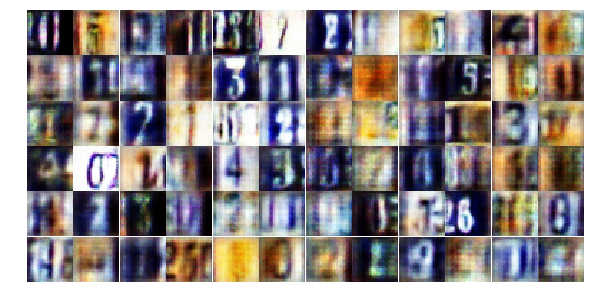

Epoch 73/100... Discriminator Loss: 1.3507... Generator Loss: 0.5974
Epoch 73/100... Discriminator Loss: 1.0395... Generator Loss: 0.8039
Epoch 74/100... Discriminator Loss: 1.4969... Generator Loss: 0.5650


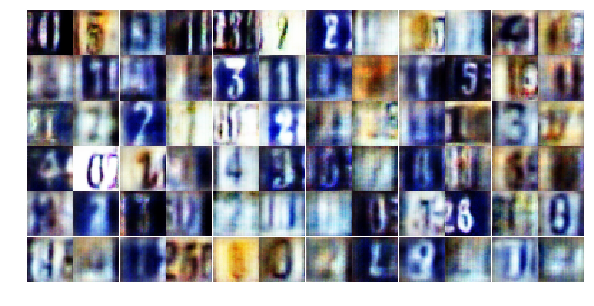

Epoch 74/100... Discriminator Loss: 1.4001... Generator Loss: 0.6322
Epoch 74/100... Discriminator Loss: 1.3048... Generator Loss: 0.6441
Epoch 74/100... Discriminator Loss: 1.3174... Generator Loss: 0.6403
Epoch 74/100... Discriminator Loss: 1.1188... Generator Loss: 0.6782


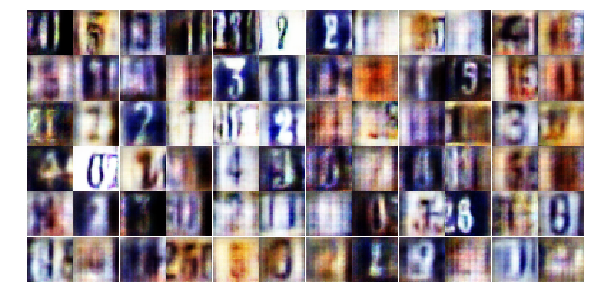

Epoch 74/100... Discriminator Loss: 1.9972... Generator Loss: 0.5065
Epoch 75/100... Discriminator Loss: 1.6231... Generator Loss: 0.5734


KeyboardInterrupt: 

In [21]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5),
                        show_every=batch_size*10, print_every=batch_size*3)

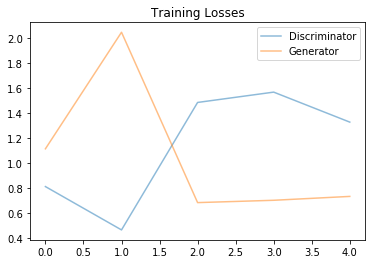

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

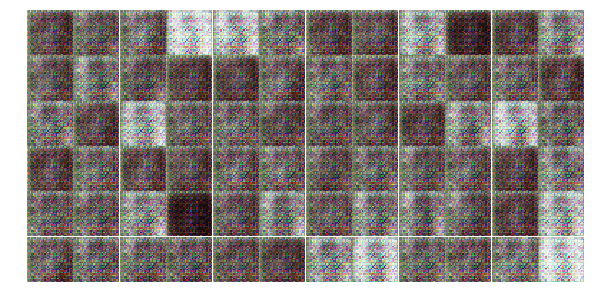

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))